In [1]:
import numpy as np

import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
import tensorflow.keras.backend as kbck

from IPython.display import Image, HTML 
from PIL import Image, ImageDraw

import sys
import os

sys.path.append(os.getcwd())

import itertools
import ImgGenerator

tf.keras.backend.clear_session()  # For easy reset of notebook state.

def create_input_layers(inp_layer, layer_prefix, algs = ["dense", "lstm", "conv"]):
    result = []
    if "lstm" in algs:
        lstm = layers.LSTM(units=128, name=f"lstm-inp_{layer_prefix}")(inp_layer)
        lstm = layers.Flatten()(lstm)
        print(lstm)
        result.append(lstm)
        
    if "dense" in algs:
        dense = layers.Dense(32, name=f"dense-inp_{layer_prefix}")(inp_layer)
        dense = layers.Flatten()(dense)
        print(dense)
        result.append(dense)
    
    if "rnn" in algs:
        rnn = layers.SimpleRNN(128*128, name=f"rnn-inp_{layer_prefix}")(inp_layer)
        print(rnn)
        result.append(rnn)
    
    if "conv" in algs:
        conv = layers.Conv1D(32, 3, padding="same", name=f"conv1_{layer_prefix}")(inp_layer)
        conv = layers.Flatten()(conv)
        print(conv)
        result.append(conv)
    return result
    
in_top = keras.Input(shape=( ImgGenerator.H, ImgGenerator.W//2), name='inp-top')
in_left = keras.Input(shape=( ImgGenerator.H, ImgGenerator.W//2), name='inp-left')
#in_all = keras.Input(shape=( 2, ImgGenerator.H, ImgGenerator.W//2), name='inp-all')
in_interlaced = keras.Input(shape=( ImgGenerator.H, ImgGenerator.W), name='inp-interlaced')

#conv = layers.DepthwiseConv2D(
#    (2,2), padding="same", data_format='channels_first', name=f"depth-conv")(in_interlaced)
#conv = layers.Flatten()(conv)
#print(conv)

lstm = layers.LSTM(units=512, name=f"lstm")(in_interlaced)
#lstm = layers.Dense(1024, activation="relu", name=f"lstm-dense")(lstm)

concats = layers.Concatenate()([
        #conv,
        lstm, 
        *create_input_layers(in_top, "top", ["dense", "conv"]), 
        *create_input_layers(in_left, "left", ["dense", "conv"])])
#all_inps = layers.Flatten()(all_inps)

print(f"Concatenated:{concats}")

d1 = layers.Dense(128*128, name=f"dense-all_inp", activation="relu")(concats)
#all_inps = layers.BatchNormalization(momentum=0.2)(all_inps)
d2 = layers.Dense(128*128, activation="relu")(d1)#,, activation="softplus"

output = layers.Dense(128*128, activation="tanh")(d2)#,, activation="softplus"
print(f"All inps:{output}")

output = layers.Reshape((128, 128))(output)
print(f"Out layer:{output}")


Tensor("flatten/Identity:0", shape=(None, 4096), dtype=float32)
Tensor("flatten_1/Identity:0", shape=(None, 4096), dtype=float32)
Tensor("flatten_2/Identity:0", shape=(None, 4096), dtype=float32)
Tensor("flatten_3/Identity:0", shape=(None, 4096), dtype=float32)
Concatenated:Tensor("concatenate/Identity:0", shape=(None, 16896), dtype=float32)
All inps:Tensor("dense_1/Identity:0", shape=(None, 16384), dtype=float32)
Out layer:Tensor("reshape/Identity:0", shape=(None, 128, 128), dtype=float32)


In [2]:
model = keras.Model(inputs=[in_top, in_left, in_interlaced], outputs=output)
#model = keras.Model(inputs=x, outputs=output)
model.summary()
optimizer = tf.keras.optimizers.Ftrl(
    learning_rate=0.001) 
opt = tf.keras.optimizers.Nadam (
    learning_rate=0.0001)
model.compile( loss=tf.keras.losses.CosineSimilarity(), metrics=["acc"], optimizer=opt)# msle loss="mse", optimizer="Adam"


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
inp-top (InputLayer)            [(None, 128, 64)]    0                                            
__________________________________________________________________________________________________
inp-left (InputLayer)           [(None, 128, 64)]    0                                            
__________________________________________________________________________________________________
inp-interlaced (InputLayer)     [(None, 128, 128)]   0                                            
__________________________________________________________________________________________________
dense-inp_top (Dense)           (None, 128, 32)      2080        inp-top[0][0]                    
______________________________________________________________________________________________

In [16]:
Xnor = 64.
Ynor = 255.
N = 30


def generate_set(num):
    train_left, train_top, train_interlaced, train_y = ([],[],[],[])
    for top, left, y in itertools.islice( ImgGenerator.produce_numpy_sample(), 0, num ):
        train_top.append(top) #train_x.append(np.expand_dims(x, 0))
        train_left.append(left) #train_x.append(np.expand_dims(x, 0))
        #train_all.append(np.stack((top.reshape(128, 64), left.reshape(128, 64))))
        train_interlaced.append( np.hstack((top, left)) )
        train_y.append(y/Ynor) #
    #train_all = np.stack(train_all)
    train_top = np.stack(train_top)
    train_left = np.stack(train_left)
    train_interlaced = np.stack(train_interlaced)
    train_y = np.stack(train_y)
    return ({'inp-top':train_top, 'inp-left':train_left,
             #, 'inp-all':train_all
             'inp-interlaced':train_interlaced,
            }, train_y)

#_, x, _ = generate_set(5)
#print(f"{x.shape}\n{x}")
def display_predict(prediction, expected):
    
    for p, y in zip(
            (prediction * Ynor), 
            (expected*Ynor).astype(np.uint8)):
        p_mean = np.mean(p)
        print(f"Source item-max={np.amax(y)}, source-shape:{y.shape}, predictions: shape:{p.shape} :mean{p_mean}")
        iy = Image.fromarray(y, 'L')
        p_grey = p
        p_grey[p_grey > 255.] = 255.
        p_grey[p_grey < 0] = 0.
        p_grey = p_grey.astype(np.uint8)
        ip = Image.fromarray(p_grey, 'L')
        ip_bw = Image.fromarray( ((p > p_mean).astype(np.int)*255).astype(np.uint8), 'L')

        tub = Image.new("RGB", ((ImgGenerator.W+1)*3, ImgGenerator.H))
        tub.paste(iy, (0, 0, ImgGenerator.W, ImgGenerator.H))
        tub.paste(ip, (ImgGenerator.W+1, 0))
        tub.paste(ip_bw, ((ImgGenerator.W+1)*2, 0))
        #tub.paste( Image.fromarray(x255, 'L'), ((ImgGenerator.W+1)*3, 0))
        display(tub)


Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7726 - acc: 0.0906
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8200 - acc: 0.1600
Epoch 3/6
2/2 [==============================] - 14s 7s/step - loss: -0.8363 - acc: 0.2022
Epoch 4/6
2/2 [==============================] - 14s 7s/step - loss: -0.8504 - acc: 0.1670
Epoch 5/6
2/2 [==============================] - 11s 6s/step - loss: -0.8790 - acc: 0.2105
Epoch 6/6
2/2 [==============================] - 13s 6s/step - loss: -0.8969 - acc: 0.2105
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.72622680664062


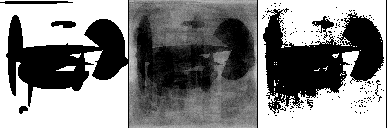

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean44.73958206176758


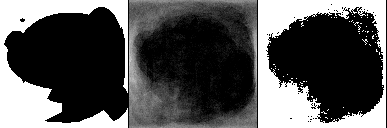

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.27555084228516


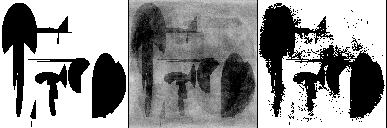

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean128.09735107421875


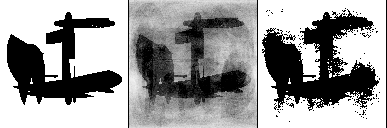

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.70905685424805


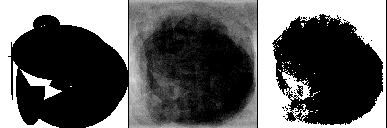

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.37251281738281


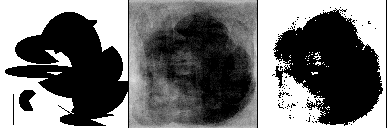

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean139.64642333984375


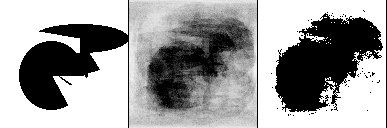

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean147.405517578125


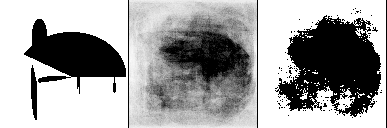

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.67428588867188


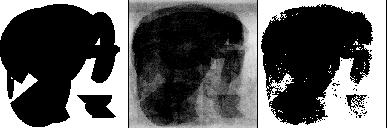

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.26485443115234


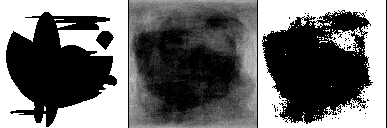

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean138.89405822753906


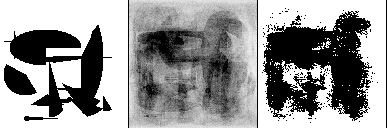

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean110.60633850097656


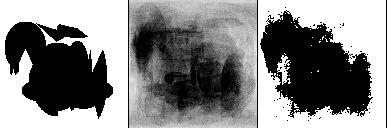

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.49116516113281


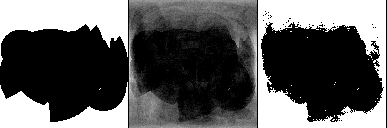

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean101.50419616699219


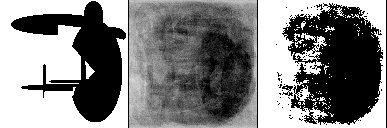

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean130.5239715576172


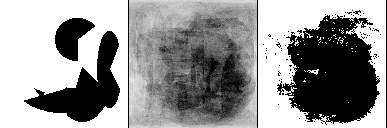

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.25890350341797


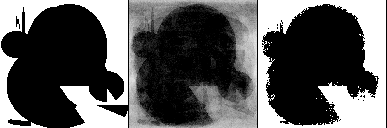

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.65214538574219


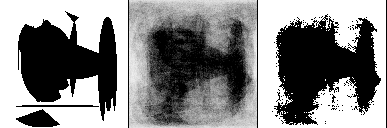

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean52.0584716796875


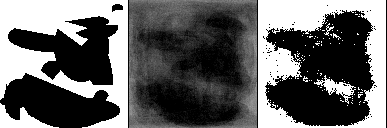

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean137.31546020507812


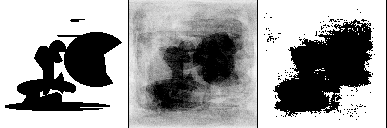

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean116.94267272949219


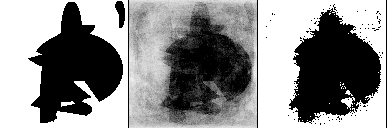

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.0981216430664


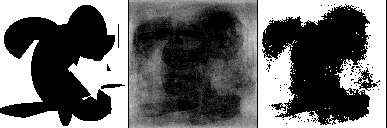

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.50259017944336


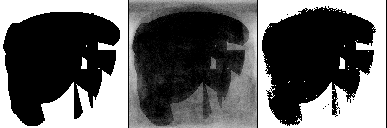

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean73.8446044921875


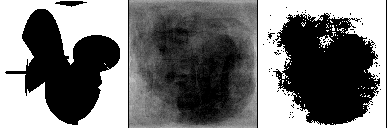

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.429931640625


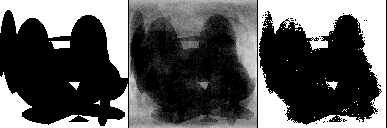

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean133.39920043945312


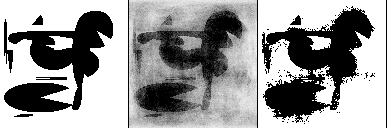

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.04887390136719


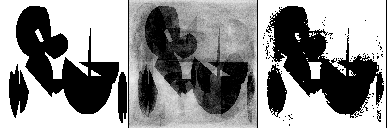

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.48826599121094


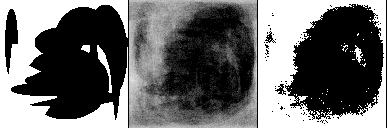

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.91801452636719


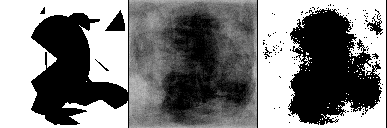

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean123.35700988769531


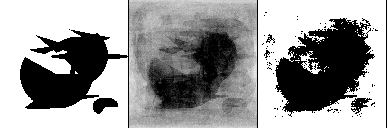

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.1761474609375


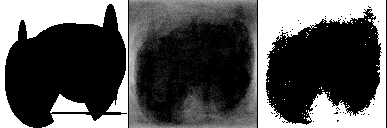

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.61574935913086


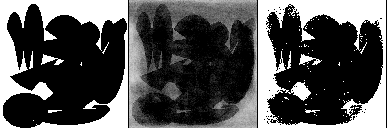

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean161.33804321289062


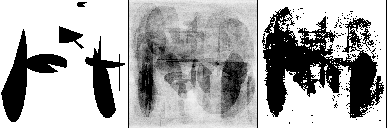

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean129.9515838623047


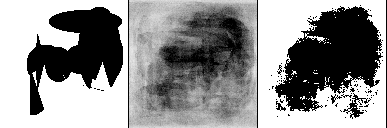

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.86585998535156


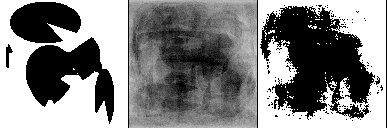

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.06478118896484


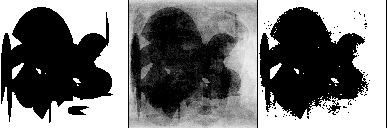

Step #0, will be saved as 'model-(000)-2src.*'


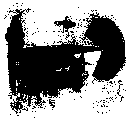

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7843 - acc: 0.2040
Epoch 2/6
2/2 [==============================] - 13s 7s/step - loss: -0.8271 - acc: 0.1632
Epoch 3/6
2/2 [==============================] - 13s 6s/step - loss: -0.8463 - acc: 0.1857
Epoch 4/6
2/2 [==============================] - 13s 7s/step - loss: -0.8691 - acc: 0.2016
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.8837 - acc: 0.1775
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9045 - acc: 0.1960
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.79475402832031


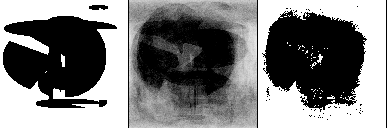

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean36.62860870361328


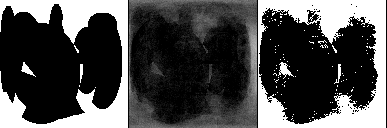

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.77857208251953


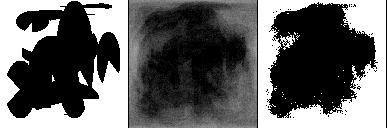

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.58432006835938


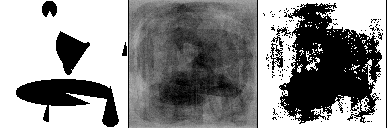

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.8373031616211


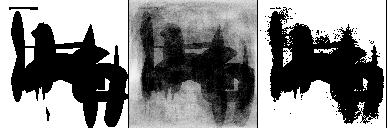

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.09097290039062


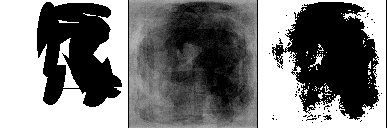

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.71513366699219


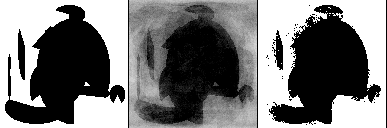

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.59597778320312


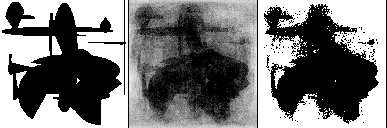

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean113.67668914794922


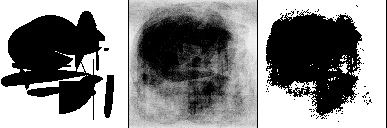

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean143.90721130371094


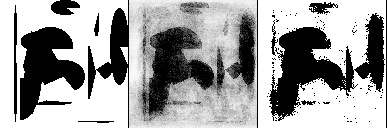

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.49746704101562


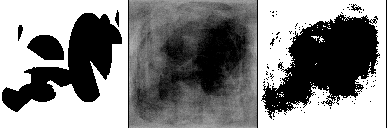

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean42.2768669128418


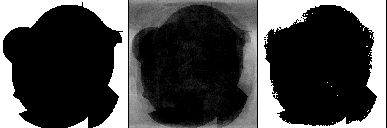

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean102.43579864501953


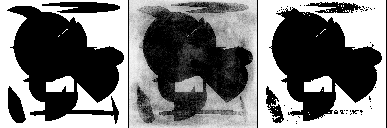

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.26216125488281


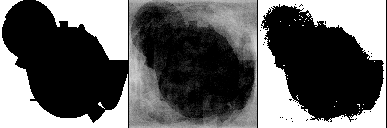

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean144.63156127929688


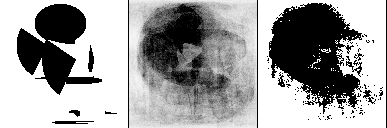

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.31645202636719


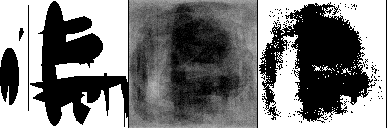

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.026611328125


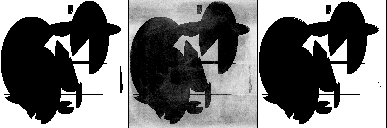

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean123.08189392089844


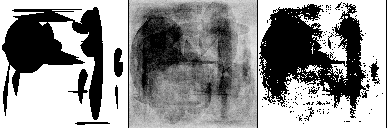

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean98.36245727539062


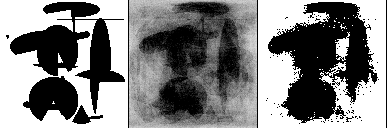

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.09599304199219


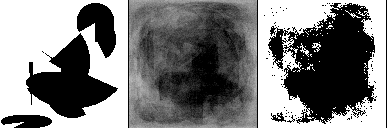

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.50251007080078


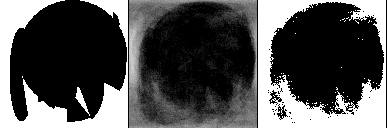

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.93679809570312


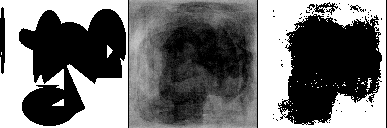

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.08058166503906


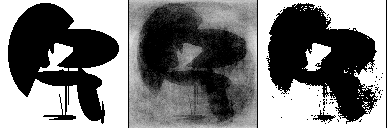

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean42.22201156616211


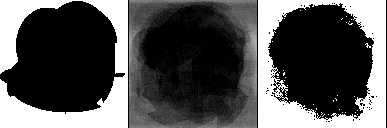

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.39749145507812


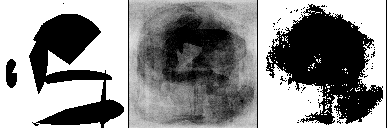

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.45120239257812


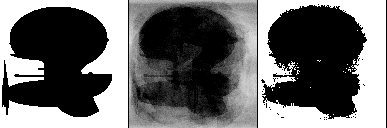

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean101.57594299316406


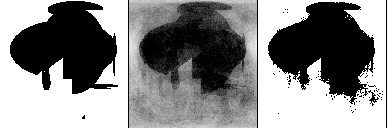

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.31090545654297


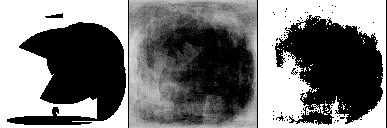

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.49215698242188


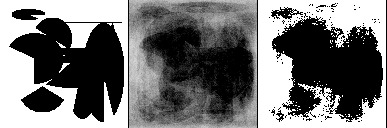

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.11080932617188


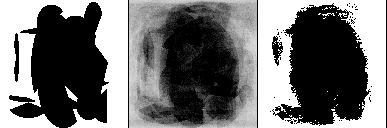

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean103.41620635986328


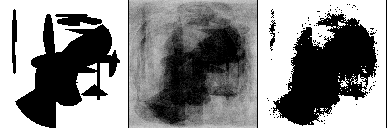

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.61255645751953


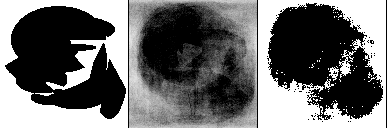

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.3105697631836


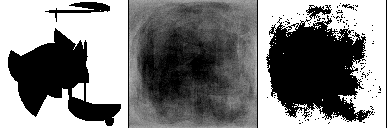

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.13133239746094


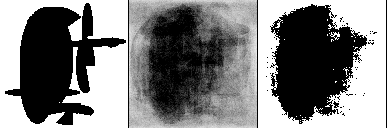

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.71022033691406


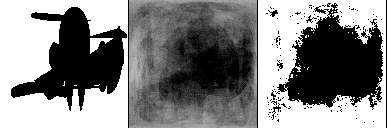

Step #1, will be saved as 'model-(001)-2src.*'


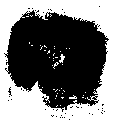

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.8033 - acc: 0.1397
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8566 - acc: 0.0801
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8737 - acc: 0.1022
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8893 - acc: 0.1063
Epoch 5/6
2/2 [==============================] - 14s 7s/step - loss: -0.9045 - acc: 0.1022
Epoch 6/6
2/2 [==============================] - 11s 6s/step - loss: -0.9224 - acc: 0.1038
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean70.94107055664062


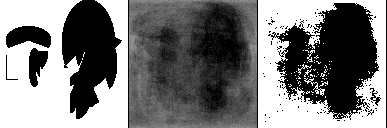

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.92684936523438


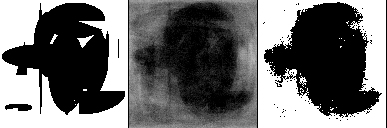

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.4880599975586


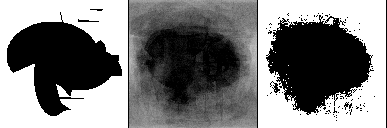

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.023681640625


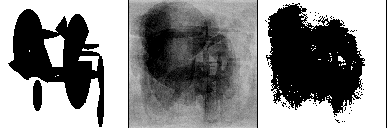

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.18630981445312


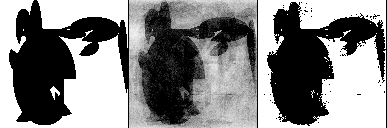

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.753173828125


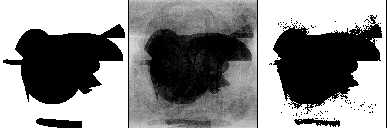

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean130.89859008789062


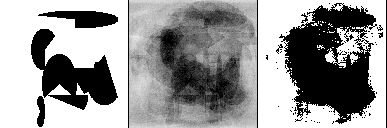

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.80122375488281


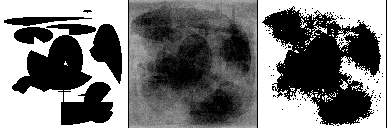

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.97149658203125


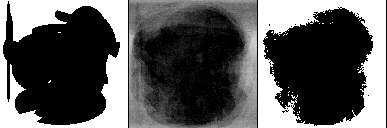

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.21102142333984


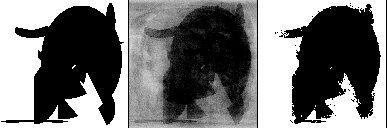

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.20755767822266


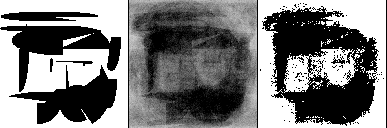

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean144.25723266601562


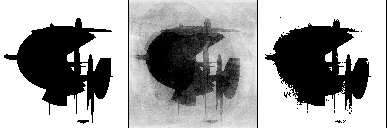

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.68309020996094


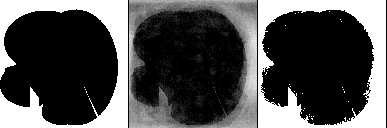

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean98.47879028320312


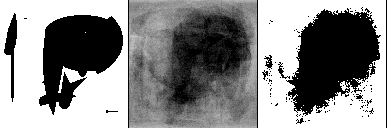

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.14075469970703


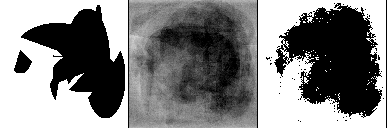

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean110.71673583984375


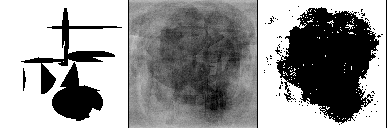

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.5304946899414


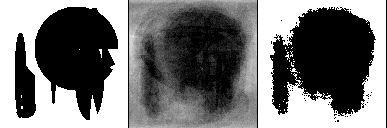

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean125.24801635742188


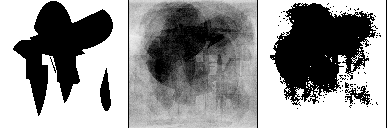

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean128.40499877929688


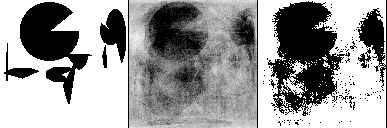

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.65985107421875


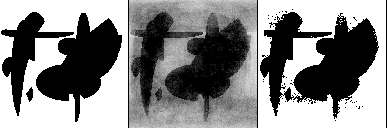

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.99468994140625


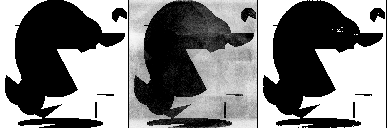

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.23260498046875


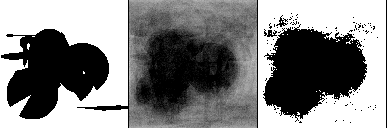

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.71051025390625


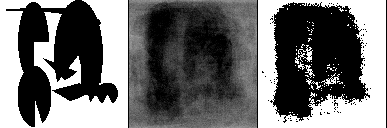

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean113.47836303710938


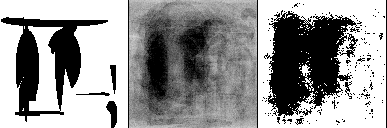

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.50874328613281


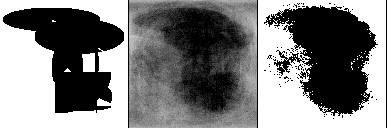

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean144.9566650390625


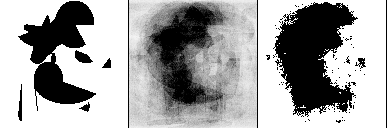

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean113.8330078125


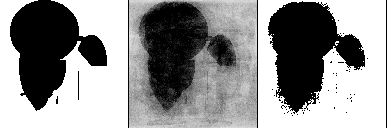

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.40206909179688


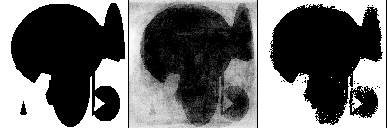

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.63939666748047


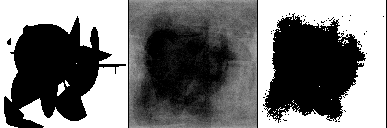

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean94.11283874511719


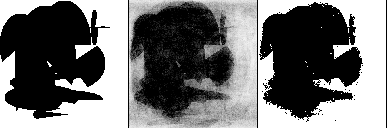

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.40696716308594


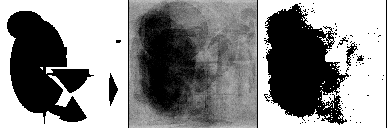

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.83295440673828


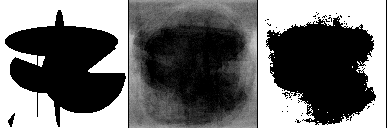

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.01840209960938


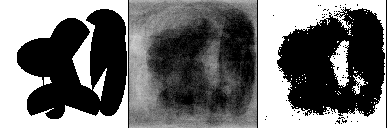

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.00918579101562


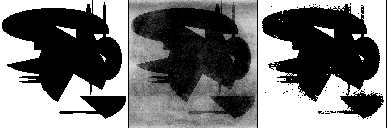

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.17918395996094


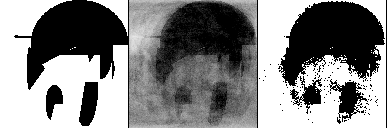

Step #2, will be saved as 'model-(002)-2src.*'


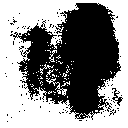

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7874 - acc: 0.1259
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8348 - acc: 0.1125
Epoch 3/6
2/2 [==============================] - 13s 7s/step - loss: -0.8618 - acc: 0.1339
Epoch 4/6
2/2 [==============================] - 14s 7s/step - loss: -0.8824 - acc: 0.1545
Epoch 5/6
2/2 [==============================] - 13s 7s/step - loss: -0.9018 - acc: 0.1688
Epoch 6/6
2/2 [==============================] - 11s 6s/step - loss: -0.9163 - acc: 0.1658
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.09367370605469


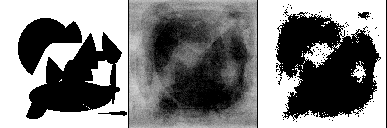

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.59707641601562


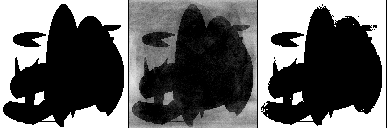

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean126.37783813476562


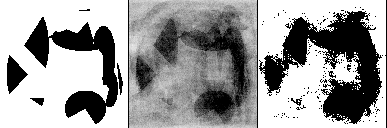

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.02449035644531


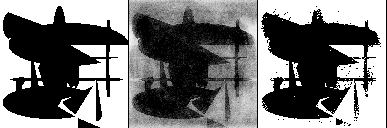

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean116.22537994384766


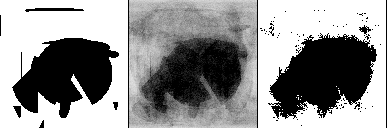

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.17349243164062


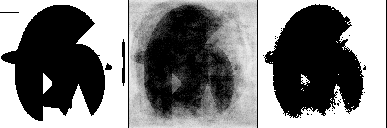

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean130.00082397460938


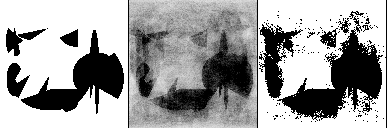

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean50.91706085205078


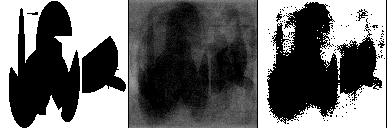

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.04361724853516


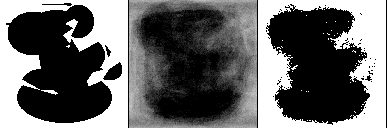

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.00061798095703


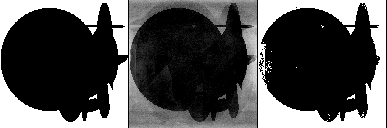

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.34568786621094


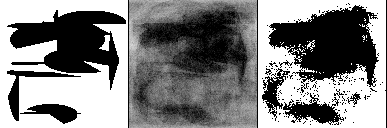

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.0408821105957


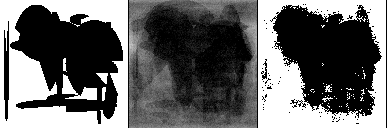

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.69171142578125


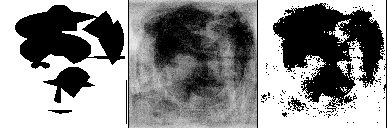

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.30264282226562


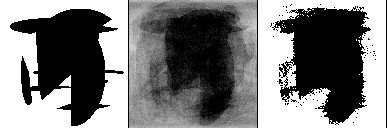

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean118.2073974609375


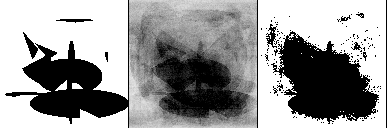

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean109.0709228515625


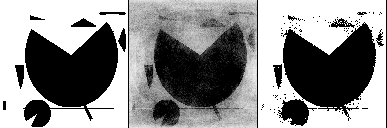

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean103.85186767578125


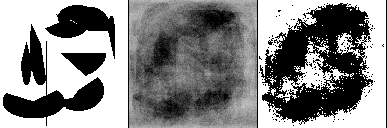

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean125.59940338134766


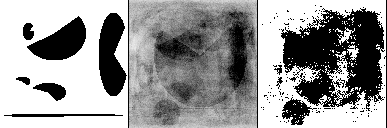

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean98.72119140625


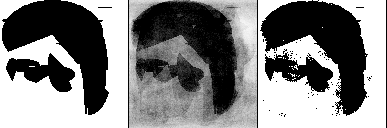

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.68421936035156


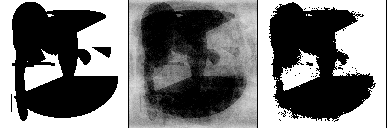

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.99905395507812


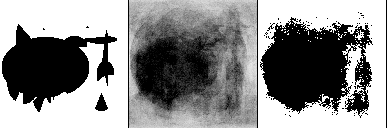

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.44570922851562


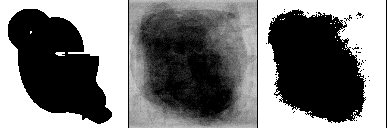

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.45386505126953


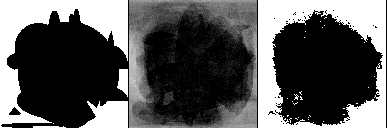

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.82613754272461


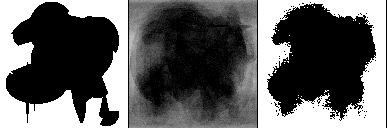

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.88029479980469


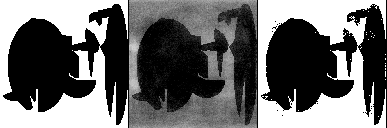

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.05078125


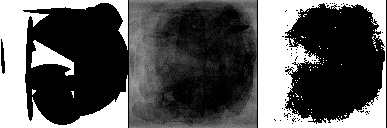

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.72229766845703


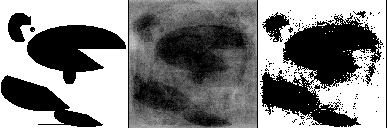

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.774742126464844


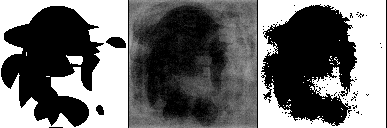

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.36125183105469


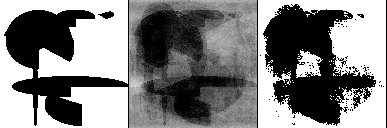

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.42640686035156


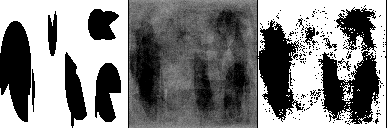

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.54417419433594


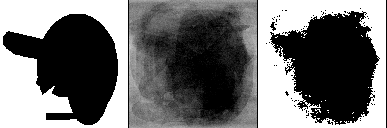

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.37104034423828


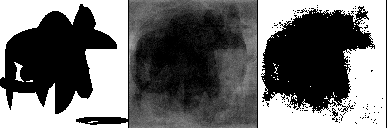

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.19448852539062


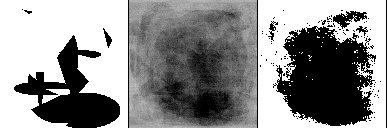

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean43.25031280517578


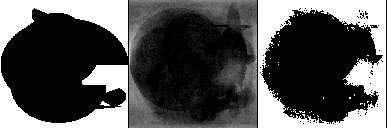

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.71031951904297


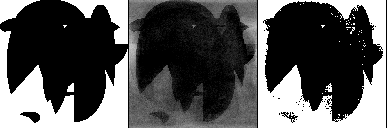

Step #3, will be saved as 'model-(003)-2src.*'


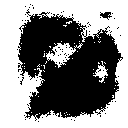

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7750 - acc: 0.1634
Epoch 2/6
2/2 [==============================] - 13s 6s/step - loss: -0.8366 - acc: 0.1473
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8610 - acc: 0.1835
Epoch 4/6
2/2 [==============================] - 11s 6s/step - loss: -0.8837 - acc: 0.2047
Epoch 5/6
2/2 [==============================] - 11s 5s/step - loss: -0.8993 - acc: 0.2212
Epoch 6/6
2/2 [==============================] - 11s 5s/step - loss: -0.9173 - acc: 0.1967
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.16840362548828


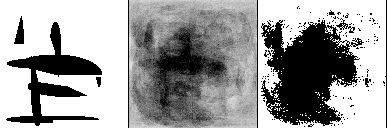

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.64411926269531


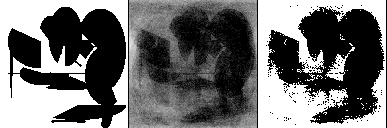

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.56587219238281


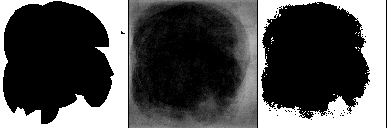

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.83537292480469


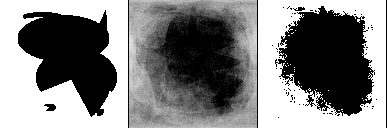

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.672607421875


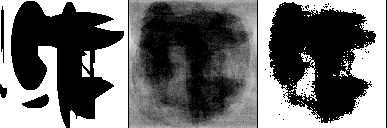

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.1281852722168


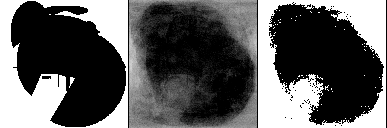

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.70530700683594


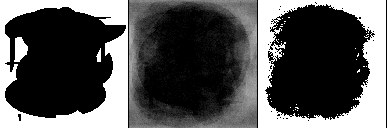

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean149.5972137451172


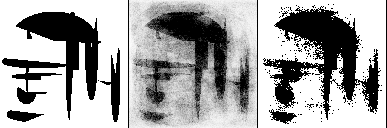

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean101.21484375


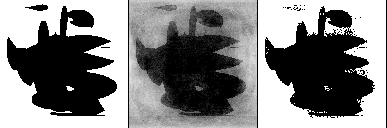

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.97625732421875


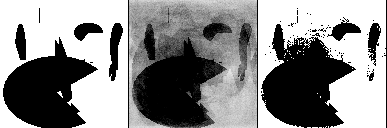

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.35392761230469


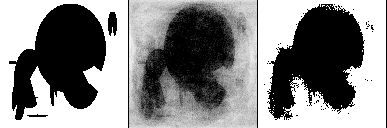

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.76982116699219


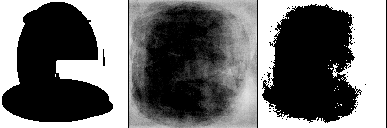

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean137.3809814453125


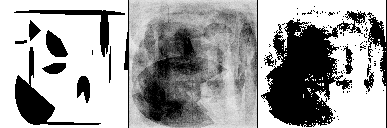

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.49960327148438


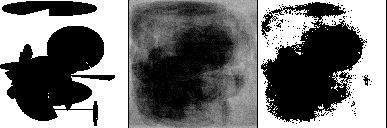

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.770267486572266


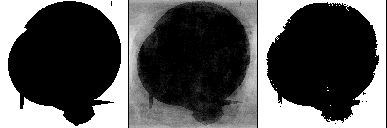

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean117.27607727050781


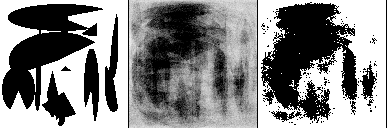

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean54.651763916015625


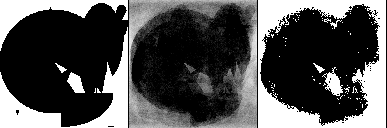

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean52.11803436279297


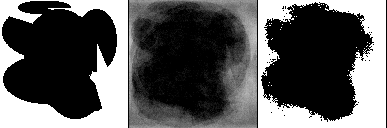

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.71156692504883


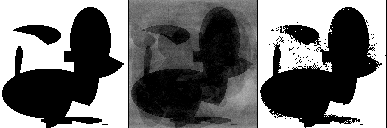

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.61927795410156


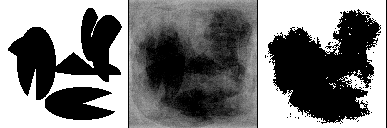

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.68364715576172


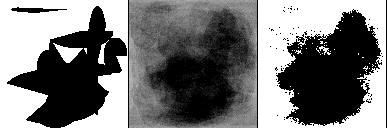

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.12451171875


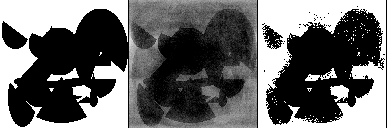

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean41.940399169921875


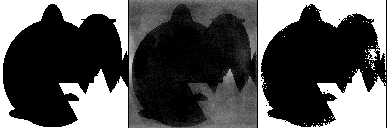

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean144.510498046875


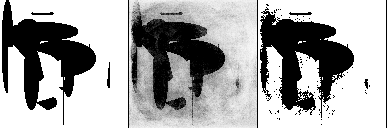

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.98972702026367


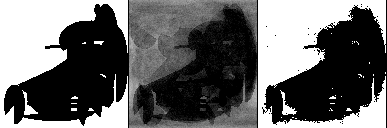

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean98.46684265136719


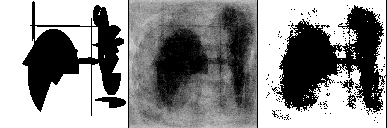

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean152.01365661621094


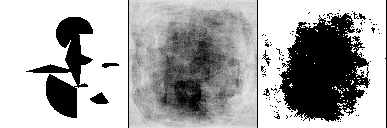

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.80325317382812


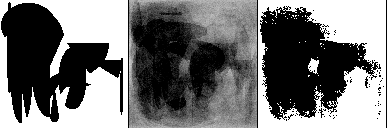

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.02067565917969


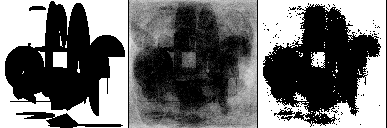

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean84.06329345703125


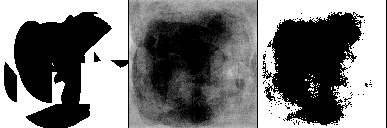

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.51545715332031


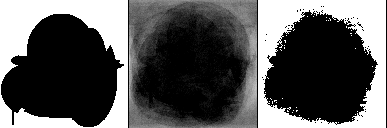

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.77732849121094


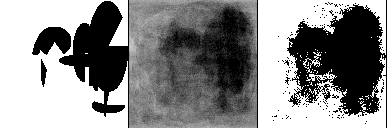

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.431827545166016


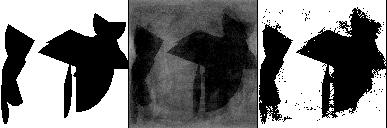

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean50.41277313232422


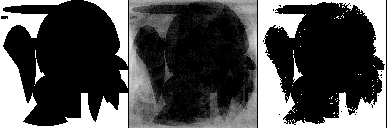

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.74951171875


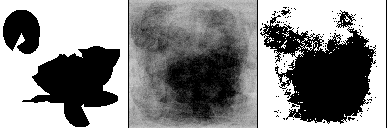

Step #4, will be saved as 'model-(004)-2src.*'


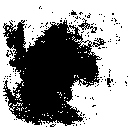

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7791 - acc: 0.2121
Epoch 2/6
2/2 [==============================] - 13s 7s/step - loss: -0.8290 - acc: 0.1663
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8552 - acc: 0.1868
Epoch 4/6
2/2 [==============================] - 13s 7s/step - loss: -0.8772 - acc: 0.2011
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.8864 - acc: 0.2047
Epoch 6/6
2/2 [==============================] - 11s 6s/step - loss: -0.9086 - acc: 0.1991
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.52789306640625


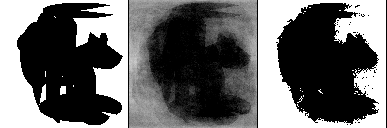

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.19880676269531


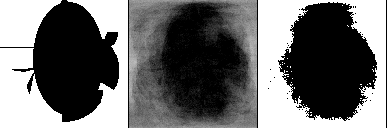

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.965476989746094


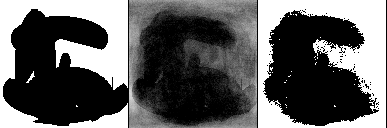

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.24288940429688


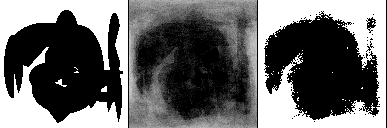

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.75103759765625


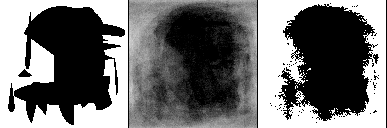

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.72443389892578


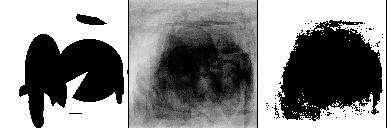

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.35248565673828


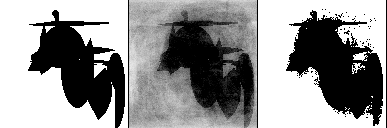

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.96713256835938


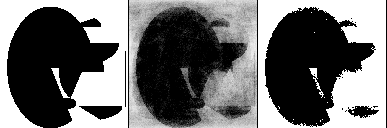

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.08543395996094


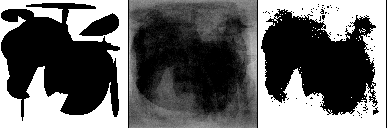

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean44.486328125


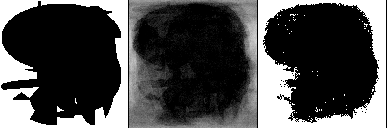

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean31.809574127197266


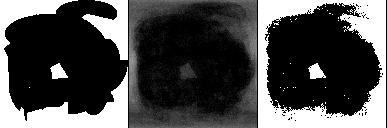

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.75838470458984


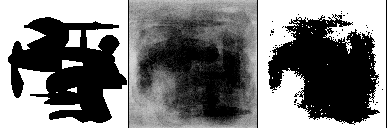

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.9886474609375


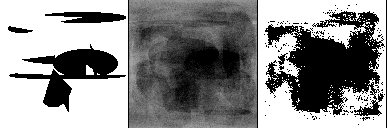

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.23444366455078


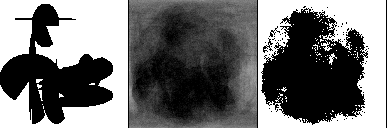

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.15084075927734


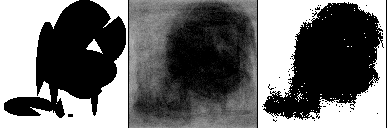

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.1825942993164


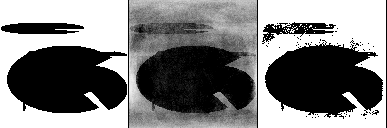

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.77043533325195


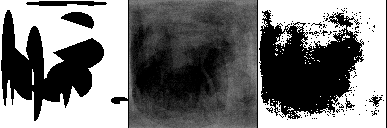

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.45501708984375


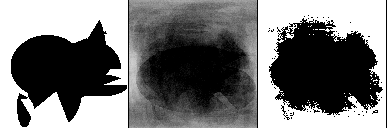

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.71600341796875


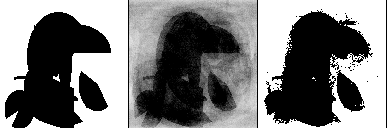

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.58489990234375


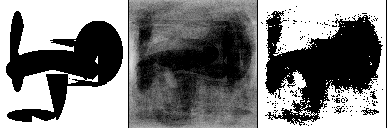

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.70941162109375


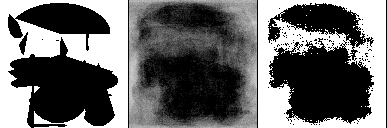

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.1948471069336


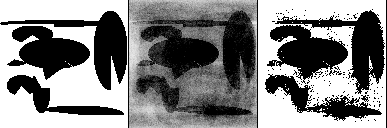

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean129.5501708984375


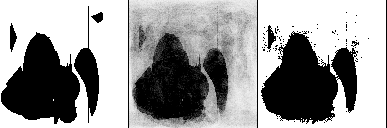

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean119.77372741699219


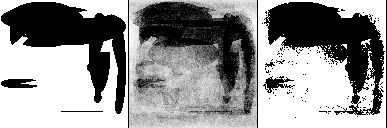

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.53579711914062


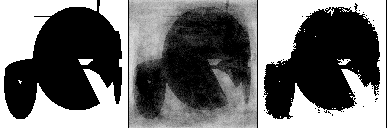

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.72479248046875


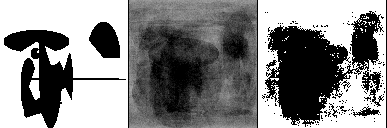

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.52938079833984


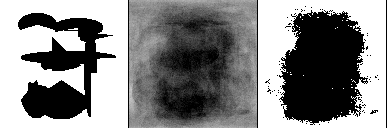

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.7255859375


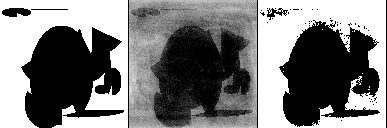

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.23605346679688


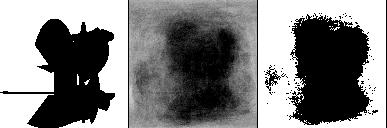

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean94.10749053955078


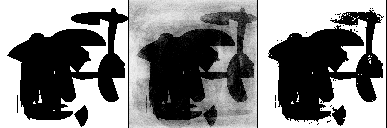

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean117.14060974121094


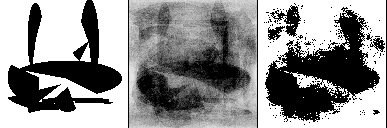

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.42754364013672


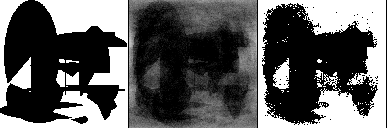

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.93226623535156


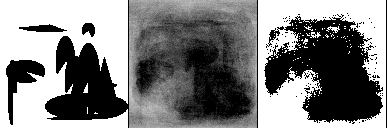

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean126.75804901123047


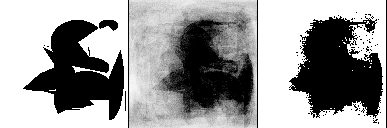

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.39082336425781


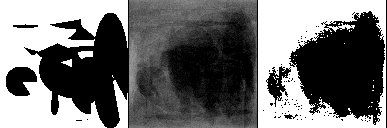

Step #5, will be saved as 'model-(005)-2src.*'


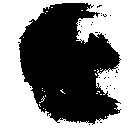

Epoch 1/6
2/2 [==============================] - 11s 6s/step - loss: -0.7767 - acc: 0.1879
Epoch 2/6
2/2 [==============================] - 11s 6s/step - loss: -0.8310 - acc: 0.1364
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8555 - acc: 0.1694
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8678 - acc: 0.1603
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.8904 - acc: 0.1741
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9060 - acc: 0.1661
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean131.56036376953125


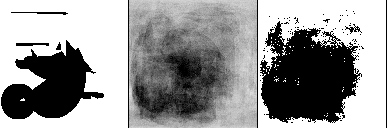

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean147.84954833984375


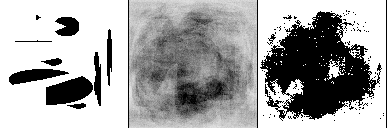

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.86532592773438


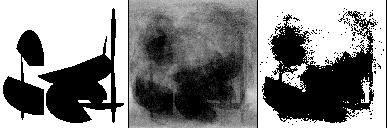

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.75347900390625


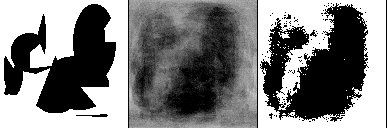

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.9421272277832


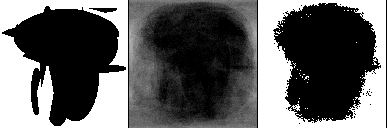

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.67972183227539


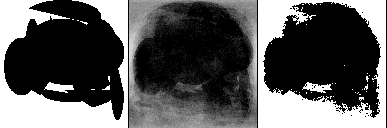

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.64022827148438


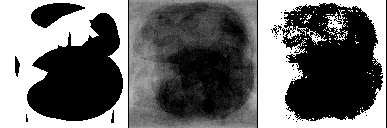

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean61.437801361083984


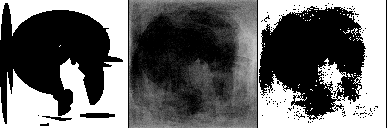

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.11233520507812


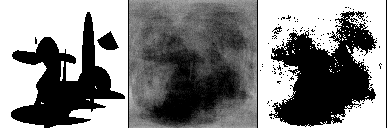

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.59942626953125


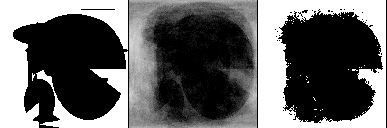

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.06678771972656


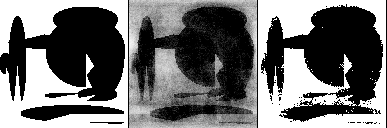

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean135.7875213623047


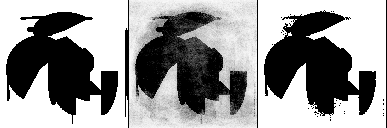

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.88356018066406


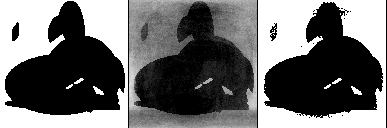

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean45.62495803833008


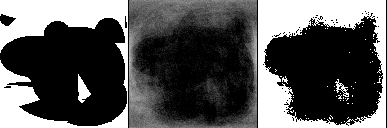

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean73.37026977539062


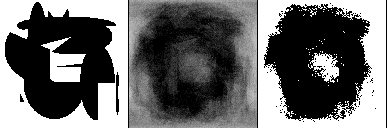

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean184.00936889648438


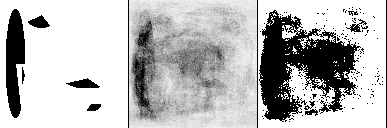

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.9180908203125


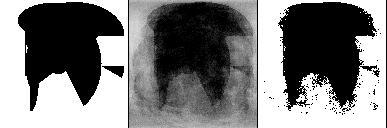

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.97491455078125


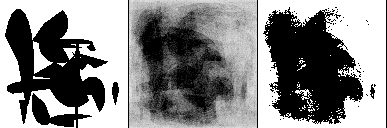

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.01589965820312


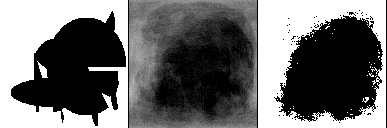

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.891685485839844


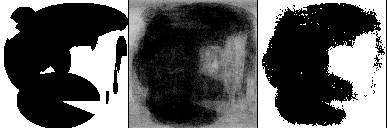

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean133.61180114746094


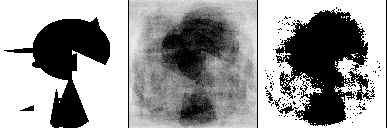

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean117.28042602539062


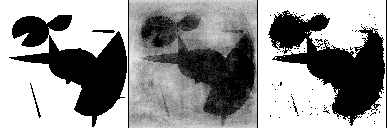

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.74173736572266


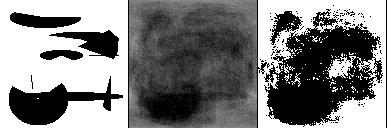

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean141.2587890625


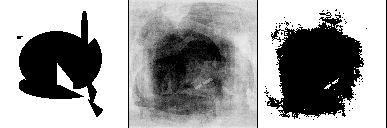

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.96522521972656


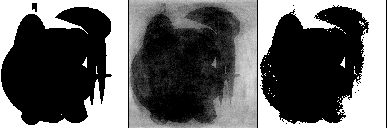

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.56237030029297


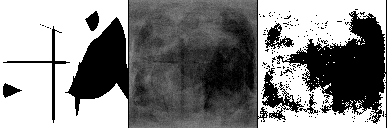

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean43.896209716796875


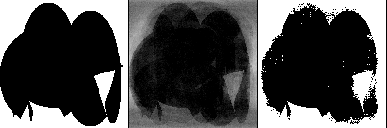

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean41.10053253173828


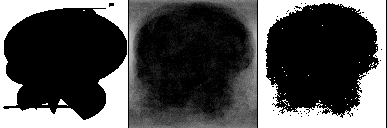

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.61286926269531


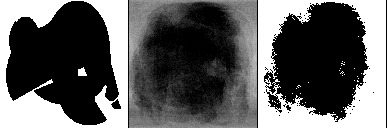

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.49018478393555


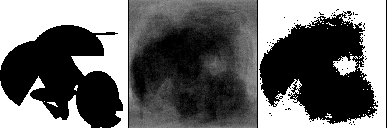

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean160.07467651367188


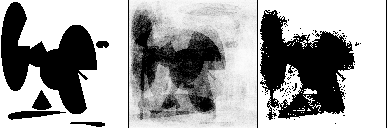

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.7752914428711


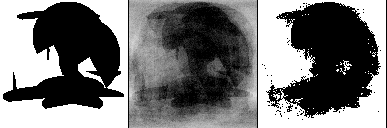

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean115.12368774414062


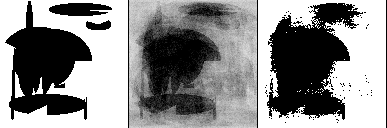

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.67312622070312


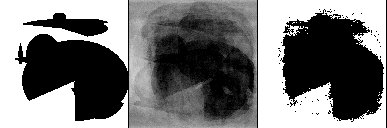

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean35.07960510253906


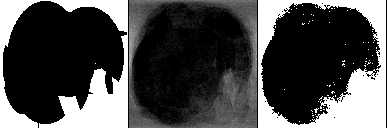

Step #6, will be saved as 'model-(006)-2src.*'


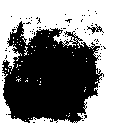

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7951 - acc: 0.1672
Epoch 2/6
2/2 [==============================] - 11s 5s/step - loss: -0.8469 - acc: 0.1116
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8704 - acc: 0.1279
Epoch 4/6
2/2 [==============================] - 11s 5s/step - loss: -0.8828 - acc: 0.1522
Epoch 5/6
2/2 [==============================] - 11s 6s/step - loss: -0.9057 - acc: 0.1254
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9202 - acc: 0.1279
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.433837890625


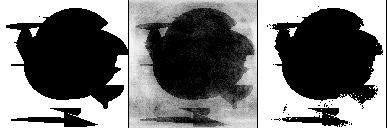

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean43.12773895263672


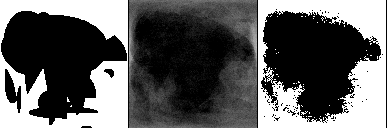

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.19157409667969


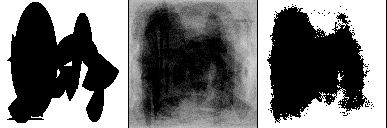

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.88948059082031


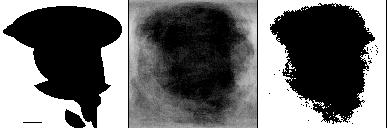

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.848880767822266


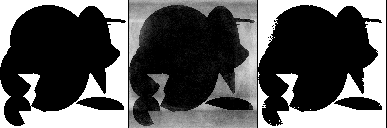

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.64595031738281


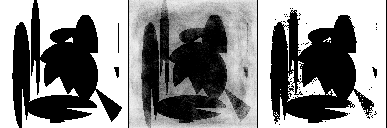

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.2445297241211


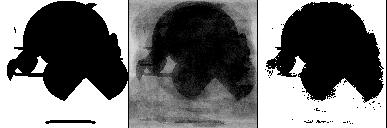

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean138.93031311035156


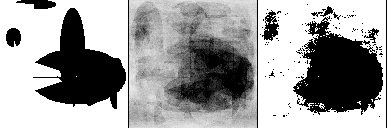

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean162.8362579345703


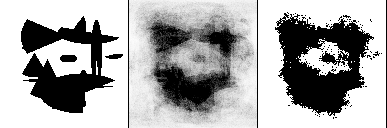

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.65393829345703


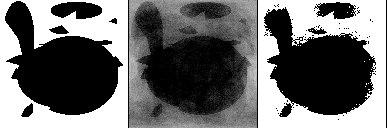

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.95516204833984


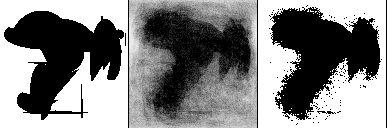

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.931175231933594


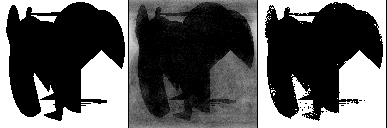

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean136.83489990234375


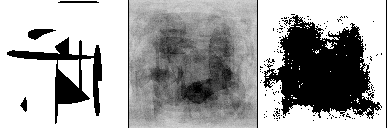

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.01782989501953


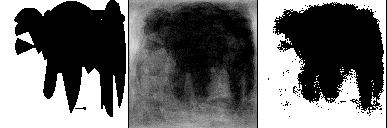

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.88453674316406


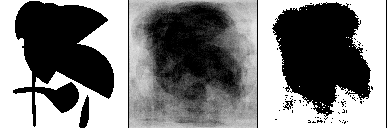

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean160.7479248046875


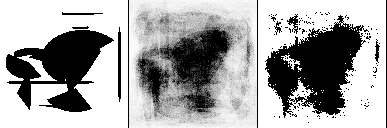

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean142.22288513183594


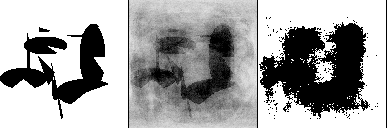

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.74898529052734


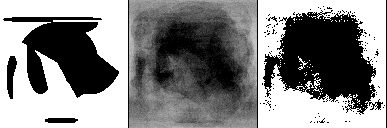

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.177650451660156


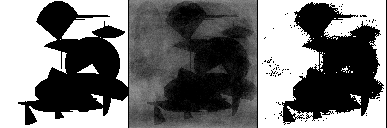

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.50668334960938


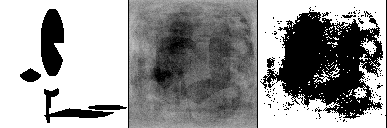

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.88165283203125


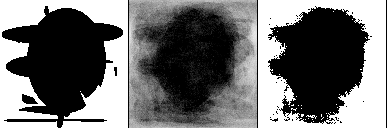

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.746826171875


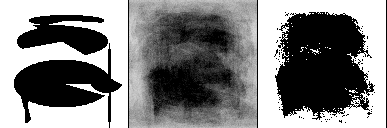

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean38.247276306152344


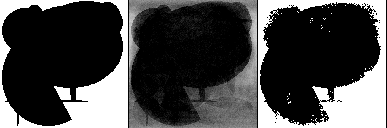

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean91.07540130615234


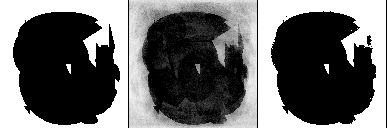

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.537818908691406


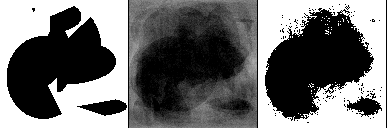

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean98.33335876464844


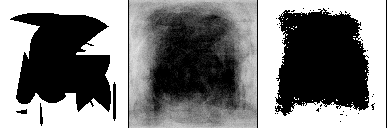

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean121.06399536132812


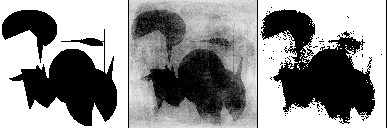

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.93022918701172


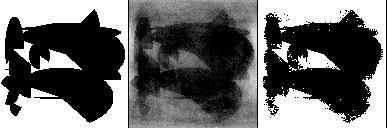

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean36.044578552246094


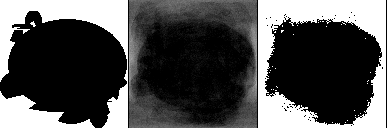

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean35.79274368286133


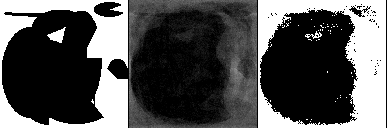

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.01383209228516


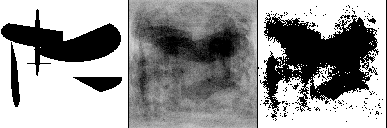

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.10050964355469


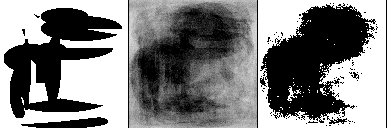

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.95597839355469


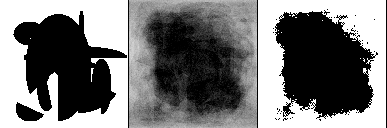

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.85108184814453


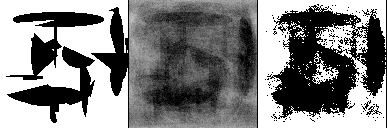

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.90742492675781


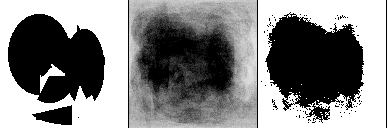

Step #7, will be saved as 'model-(007)-2src.*'


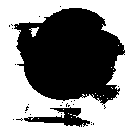

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7758 - acc: 0.1357
Epoch 2/6
2/2 [==============================] - 14s 7s/step - loss: -0.8243 - acc: 0.1060
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8624 - acc: 0.2299
Epoch 4/6
2/2 [==============================] - 13s 6s/step - loss: -0.8800 - acc: 0.2185
Epoch 5/6
2/2 [==============================] - 11s 6s/step - loss: -0.8965 - acc: 0.2056
Epoch 6/6
2/2 [==============================] - 13s 6s/step - loss: -0.9134 - acc: 0.2266
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean109.68321228027344


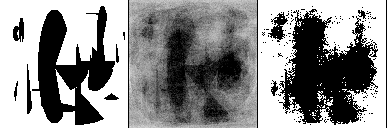

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.74485778808594


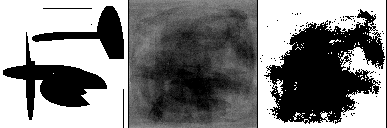

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.5826187133789


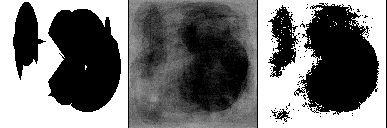

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean116.0341567993164


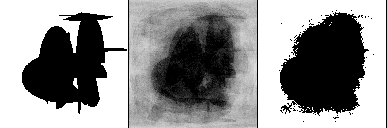

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.81244659423828


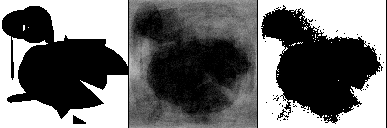

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.83296203613281


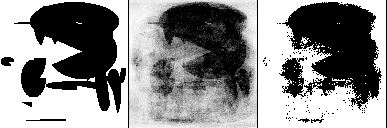

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean166.80792236328125


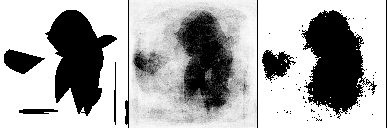

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.36936950683594


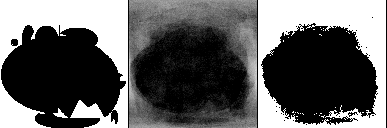

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.54037475585938


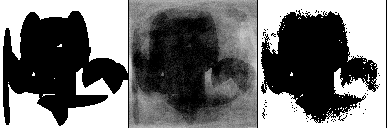

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean117.64790344238281


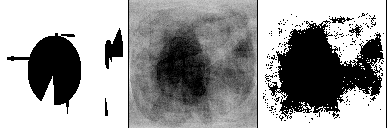

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean45.92272186279297


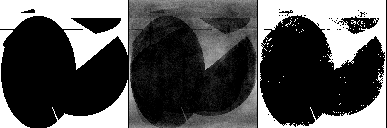

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.32485961914062


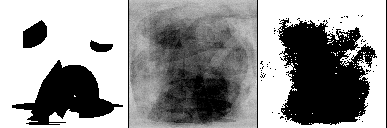

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.54438781738281


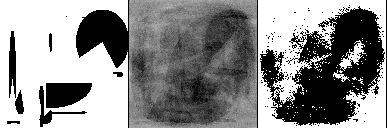

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.79722595214844


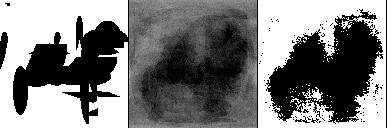

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean35.95936965942383


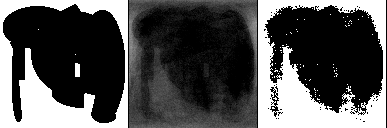

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.19727325439453


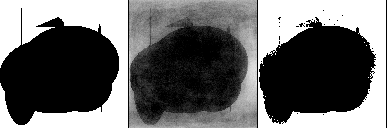

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.6937484741211


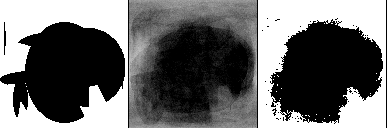

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean55.551185607910156


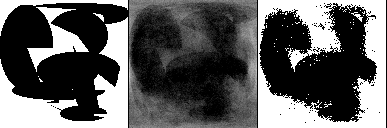

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean178.627197265625


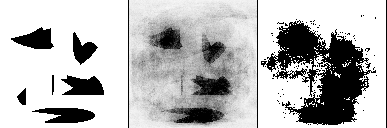

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean115.56365203857422


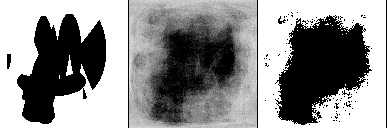

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.968711853027344


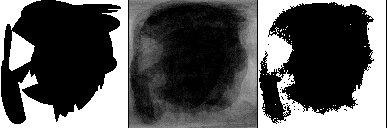

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.251708984375


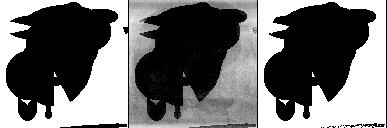

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.17713928222656


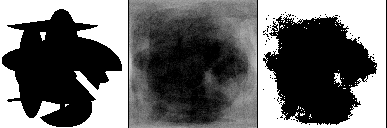

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean124.09654998779297


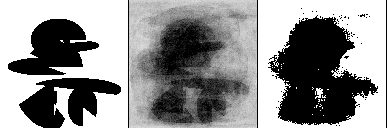

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.07331085205078


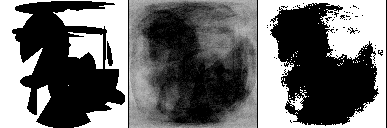

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.18799591064453


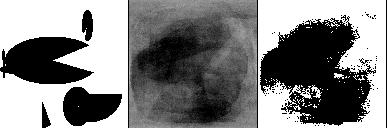

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.92002868652344


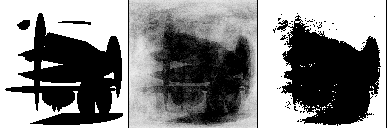

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.11683654785156


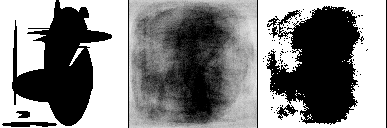

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.78182983398438


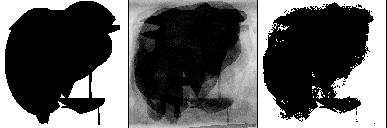

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.96138763427734


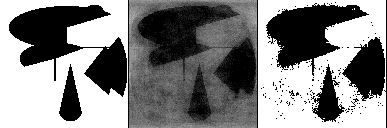

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean159.4484100341797


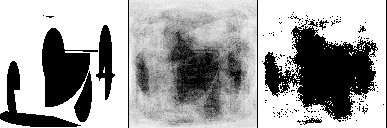

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean131.743896484375


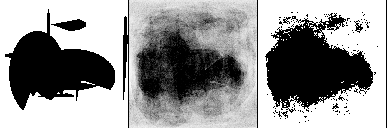

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean141.15533447265625


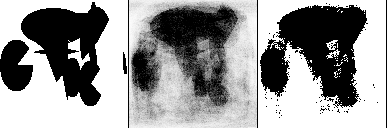

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.44091796875


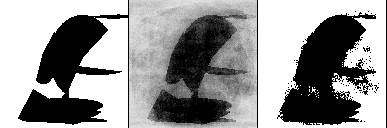

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.50499725341797


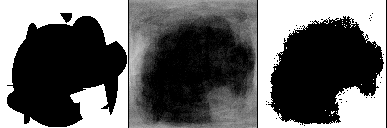

Step #8, will be saved as 'model-(008)-2src.*'


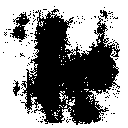

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7922 - acc: 0.1750
Epoch 2/6
2/2 [==============================] - 14s 7s/step - loss: -0.8368 - acc: 0.1770
Epoch 3/6
2/2 [==============================] - 14s 7s/step - loss: -0.8614 - acc: 0.2199
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8844 - acc: 0.2237
Epoch 5/6
2/2 [==============================] - 15s 7s/step - loss: -0.9019 - acc: 0.2136
Epoch 6/6
2/2 [==============================] - 14s 7s/step - loss: -0.9117 - acc: 0.2004
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.27447509765625


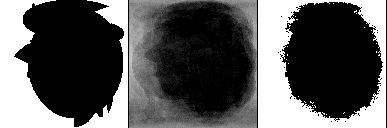

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.20005798339844


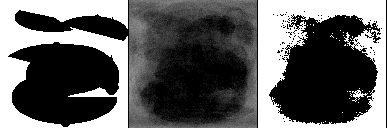

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.04552459716797


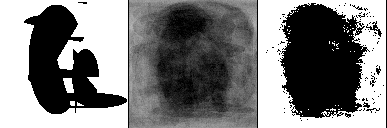

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.57771301269531


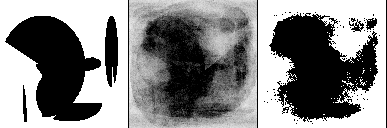

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean37.33753204345703


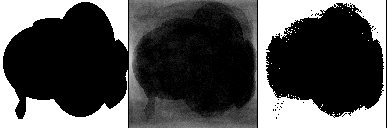

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean137.14852905273438


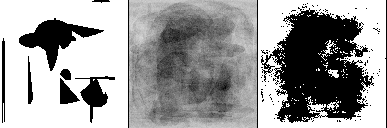

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.7835693359375


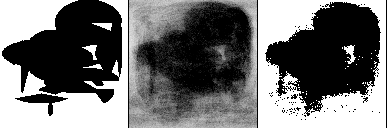

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean54.05704879760742


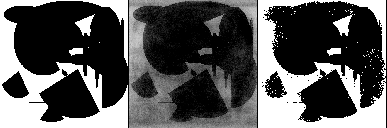

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.6031379699707


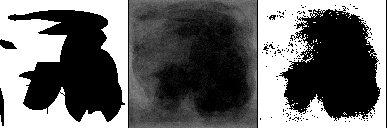

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean160.45794677734375


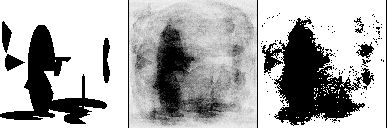

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean143.3470916748047


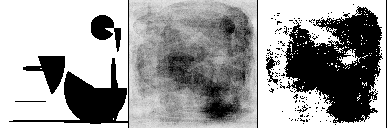

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.72799682617188


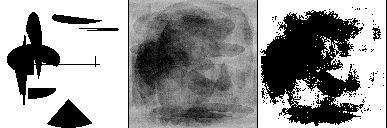

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean152.09716796875


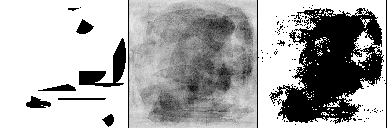

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean122.00019836425781


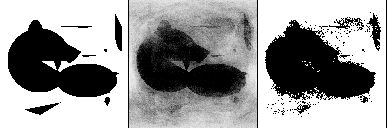

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.6932144165039


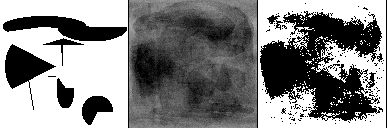

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.646114349365234


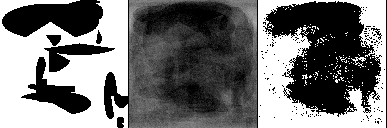

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.99333190917969


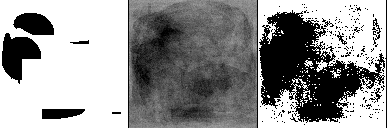

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.211669921875


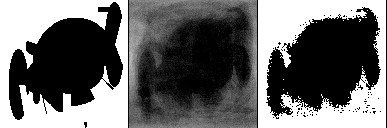

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.64805603027344


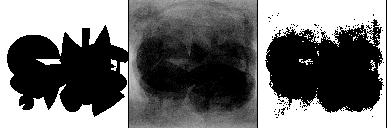

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean94.66328430175781


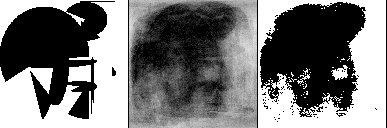

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.56101989746094


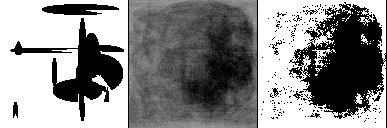

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.133216857910156


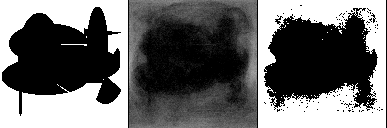

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean70.08732604980469


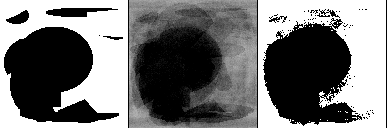

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean145.8197784423828


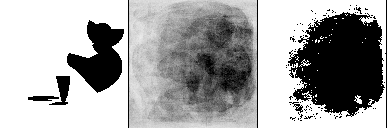

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean195.56036376953125


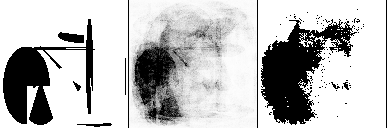

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.4052734375


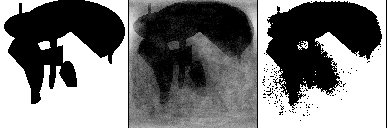

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.660255432128906


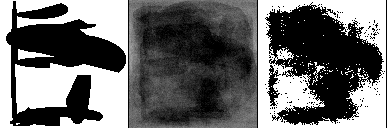

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.15646362304688


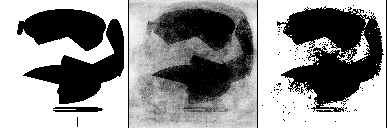

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.82369995117188


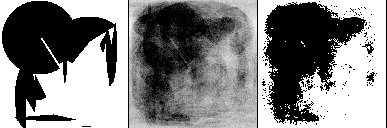

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.69912719726562


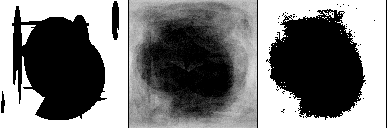

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean102.85198211669922


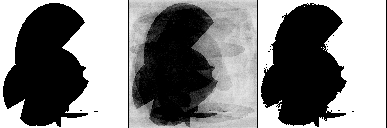

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean134.73916625976562


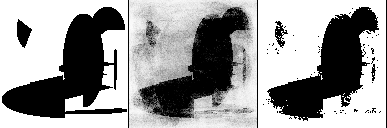

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.756744384765625


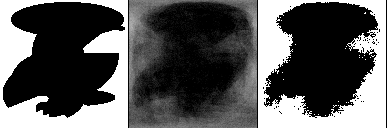

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.74291229248047


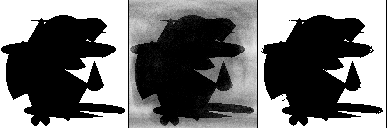

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean205.5862579345703


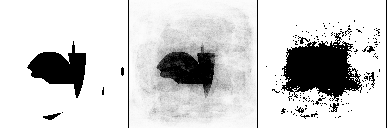

Step #9, will be saved as 'model-(009)-2src.*'


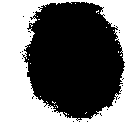

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7995 - acc: 0.1750
Epoch 2/6
2/2 [==============================] - 11s 6s/step - loss: -0.8421 - acc: 0.1420
Epoch 3/6
2/2 [==============================] - 10s 5s/step - loss: -0.8714 - acc: 0.1480
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8887 - acc: 0.1717
Epoch 5/6
2/2 [==============================] - 13s 7s/step - loss: -0.8932 - acc: 0.1502
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9170 - acc: 0.1125
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.22651672363281


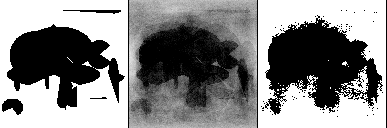

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.86787414550781


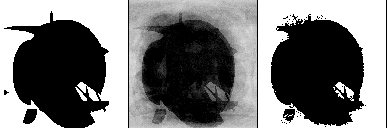

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.13250732421875


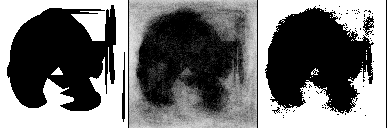

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.80548095703125


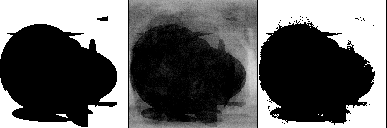

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.5328369140625


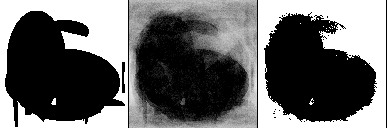

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.57039642333984


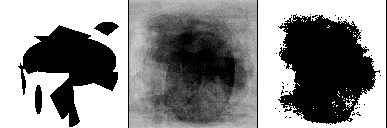

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.44650650024414


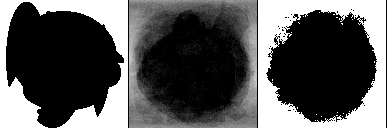

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean52.70158386230469


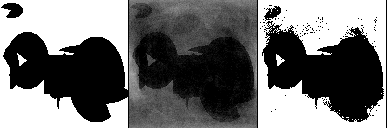

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.47663116455078


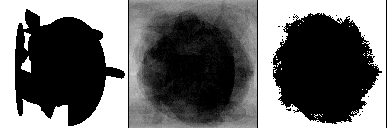

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.99944305419922


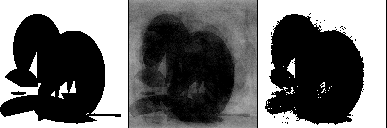

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.85670471191406


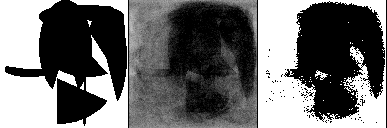

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.58219909667969


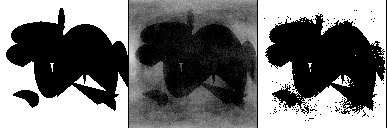

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.36618041992188


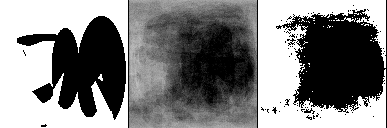

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.85379028320312


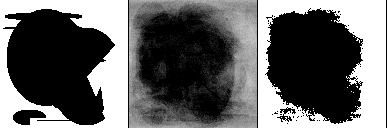

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.600830078125


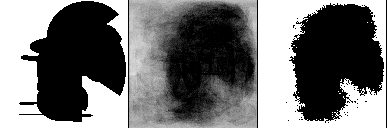

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.28292846679688


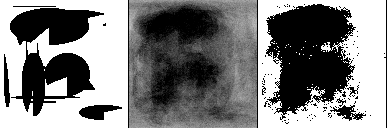

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.78707122802734


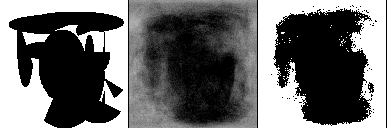

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.119293212890625


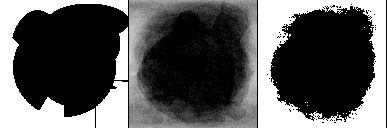

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean50.8555793762207


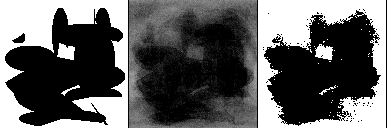

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.11656188964844


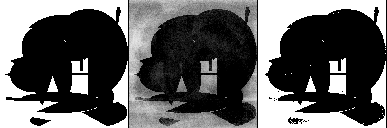

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean146.40782165527344


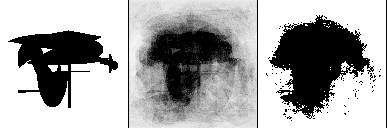

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.59770202636719


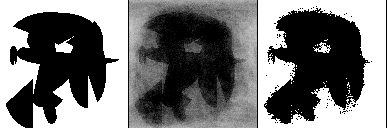

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.43501281738281


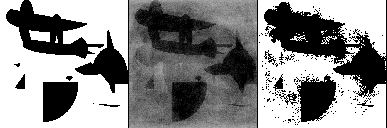

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.6485595703125


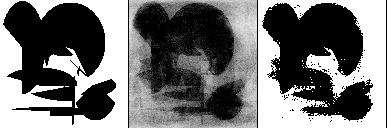

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.84962844848633


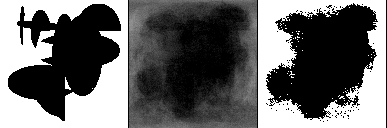

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.18635559082031


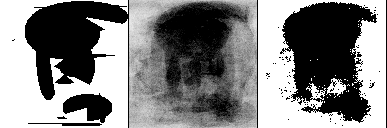

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean113.1319808959961


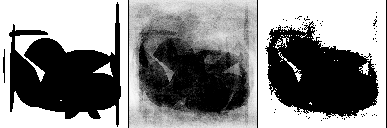

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.4164810180664


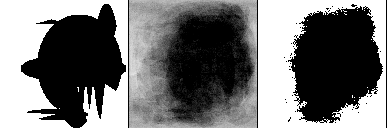

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.10404968261719


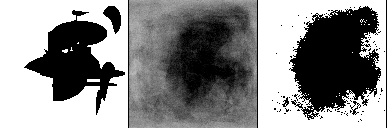

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.1797103881836


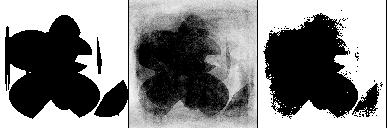

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.8970947265625


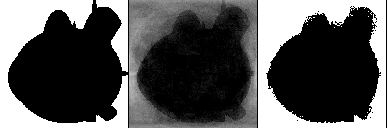

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.5760726928711


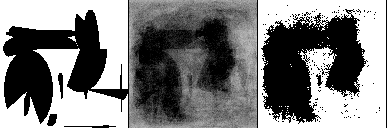

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.68624877929688


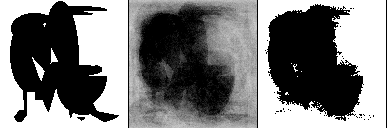

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.53784942626953


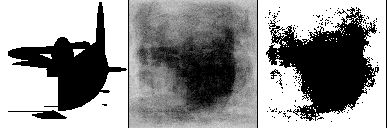

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.52276611328125


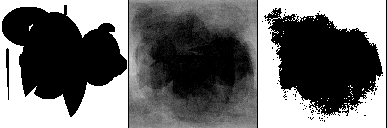

Step #10, will be saved as 'model-(010)-2src.*'


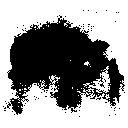

Epoch 1/6
2/2 [==============================] - 15s 7s/step - loss: -0.7960 - acc: 0.1567
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8498 - acc: 0.0725
Epoch 3/6
2/2 [==============================] - 11s 6s/step - loss: -0.8781 - acc: 0.1087
Epoch 4/6
2/2 [==============================] - 11s 5s/step - loss: -0.8949 - acc: 0.1205
Epoch 5/6
2/2 [==============================] - 11s 6s/step - loss: -0.9123 - acc: 0.1083
Epoch 6/6
2/2 [==============================] - 11s 5s/step - loss: -0.9258 - acc: 0.1199
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.34794616699219


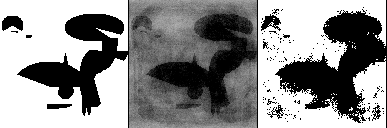

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.03412628173828


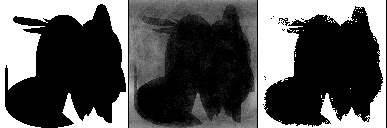

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean141.87393188476562


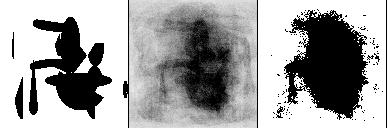

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean158.46304321289062


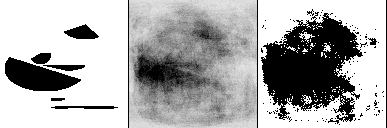

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean103.81062316894531


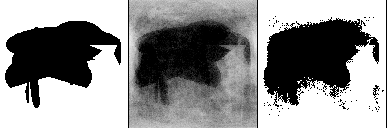

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.793060302734375


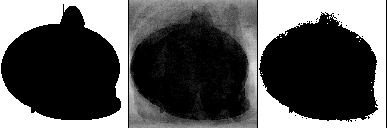

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean42.29918670654297


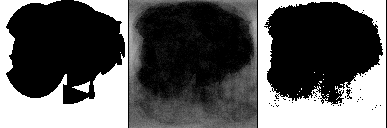

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.805633544921875


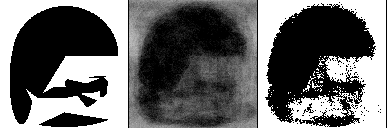

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.65483093261719


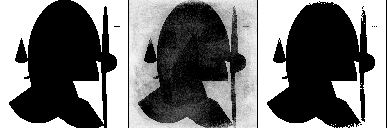

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.35607147216797


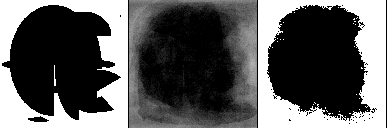

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.9261474609375


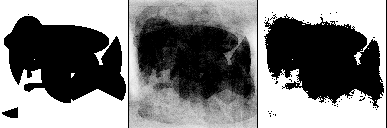

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.04241943359375


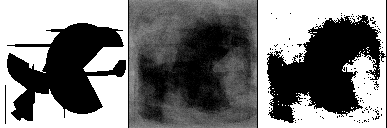

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.42716979980469


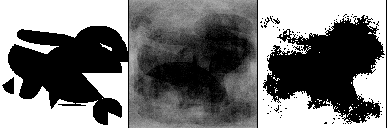

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.13329315185547


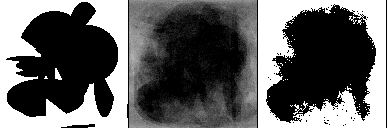

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.62884521484375


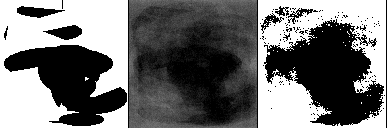

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.30878448486328


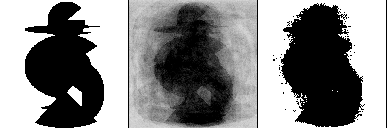

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.50934600830078


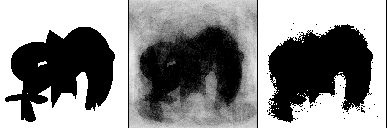

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.6406478881836


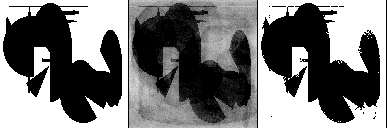

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean138.27554321289062


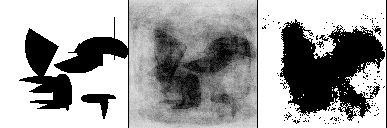

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean110.75537109375


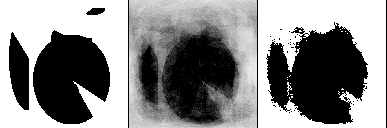

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.5863265991211


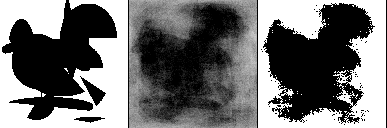

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.20435333251953


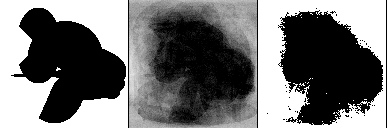

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean50.218292236328125


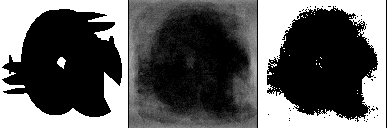

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean94.75357055664062


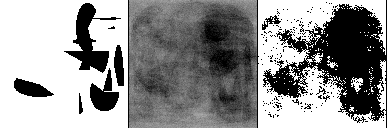

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.2676010131836


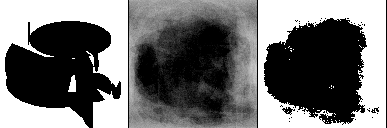

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean36.75788879394531


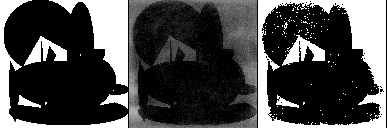

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.354515075683594


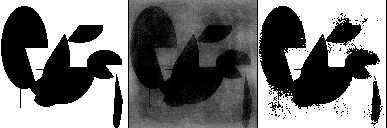

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.50762939453125


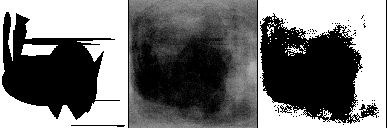

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean55.29475402832031


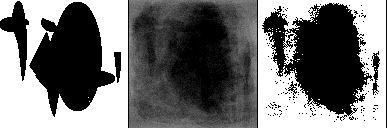

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean142.26036071777344


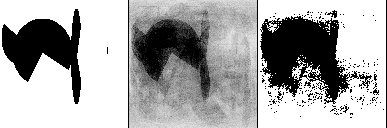

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.28221130371094


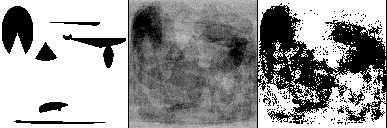

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.49992370605469


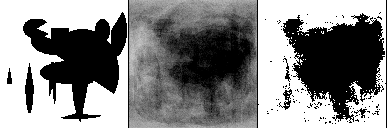

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean41.97522735595703


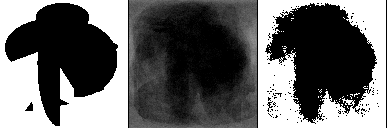

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean123.84445190429688


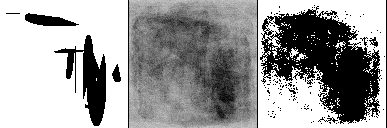

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.078277587890625


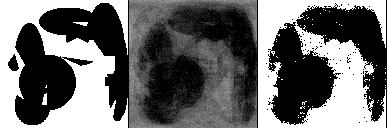

Step #11, will be saved as 'model-(011)-2src.*'


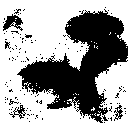

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7910 - acc: 0.1176
Epoch 2/6
2/2 [==============================] - 14s 7s/step - loss: -0.8480 - acc: 0.0804
Epoch 3/6
2/2 [==============================] - 16s 8s/step - loss: -0.8779 - acc: 0.1058
Epoch 4/6
2/2 [==============================] - 16s 8s/step - loss: -0.8958 - acc: 0.1185
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.9102 - acc: 0.1232
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9234 - acc: 0.1212
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.08879852294922


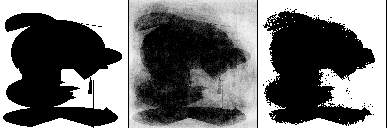

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.7490234375


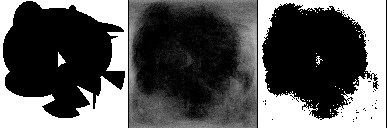

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean116.06602478027344


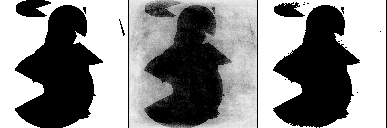

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.60188293457031


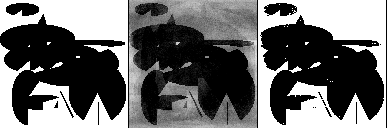

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.10432434082031


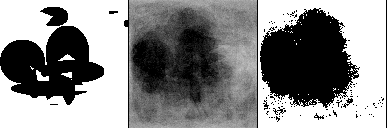

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.18415832519531


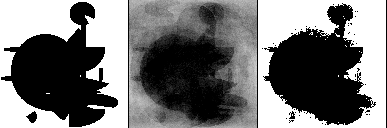

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.36134338378906


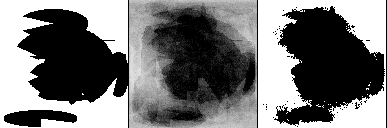

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean42.33197784423828


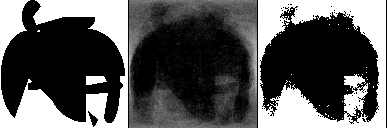

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean132.24301147460938


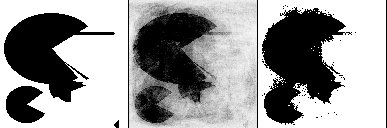

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.31831359863281


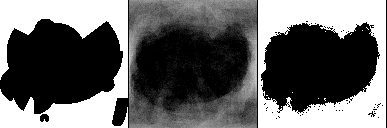

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.57881164550781


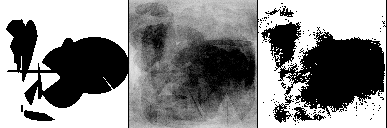

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean129.90966796875


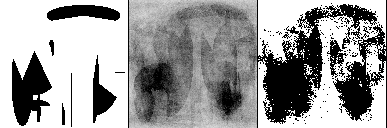

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean130.33261108398438


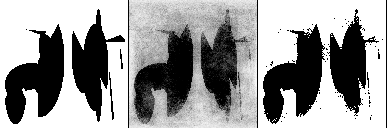

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean119.52452850341797


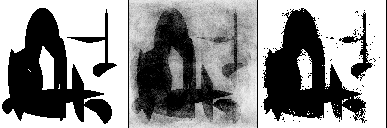

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.82426452636719


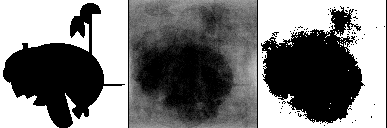

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.12759399414062


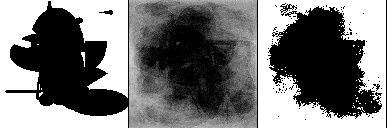

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.24536895751953


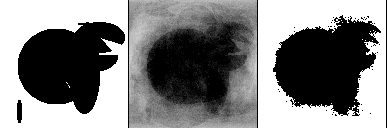

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean156.97134399414062


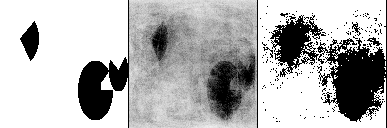

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.2939682006836


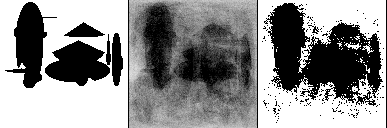

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean170.5734100341797


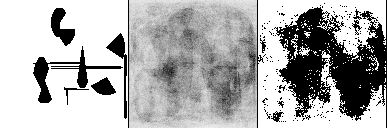

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean166.50582885742188


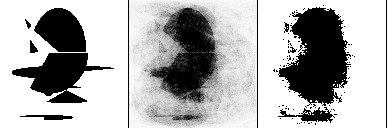

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.83195495605469


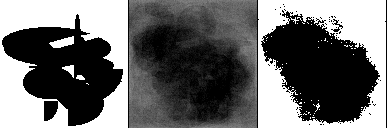

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.22357177734375


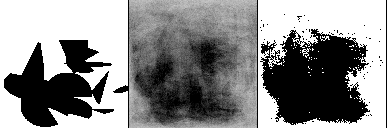

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.9520263671875


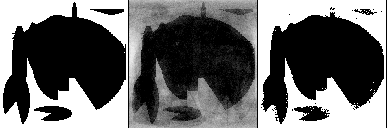

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.05736541748047


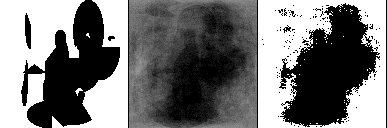

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.7733154296875


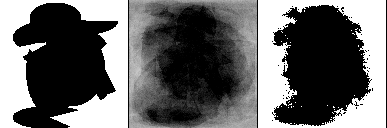

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.35301208496094


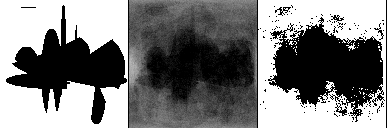

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.10009002685547


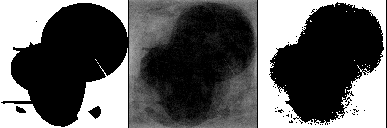

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.74224853515625


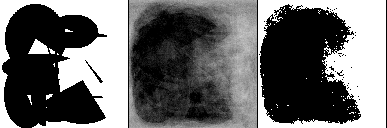

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean63.24169921875


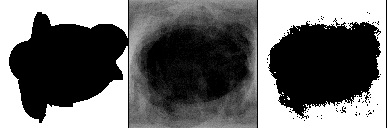

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.54888916015625


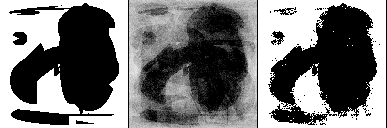

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.50674438476562


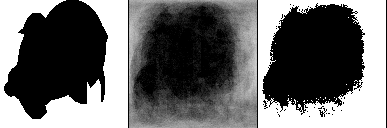

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean70.17970275878906


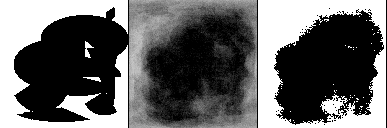

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean151.75526428222656


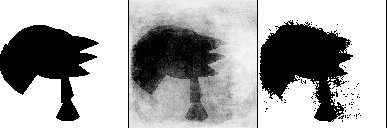

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.84204864501953


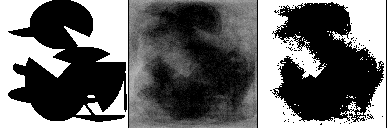

Step #12, will be saved as 'model-(012)-2src.*'


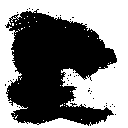

Epoch 1/6
2/2 [==============================] - 14s 7s/step - loss: -0.7878 - acc: 0.1458
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8352 - acc: 0.1045
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8588 - acc: 0.1259
Epoch 4/6
2/2 [==============================] - 13s 6s/step - loss: -0.8757 - acc: 0.1268
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.8928 - acc: 0.1426
Epoch 6/6
2/2 [==============================] - 13s 6s/step - loss: -0.9080 - acc: 0.1547
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.13218688964844


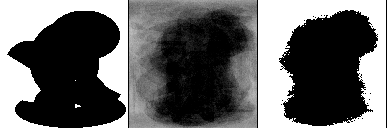

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.02357482910156


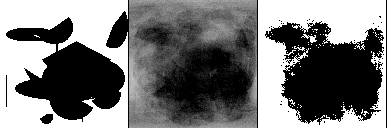

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean96.55357360839844


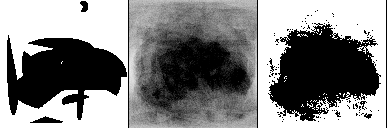

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean91.05052185058594


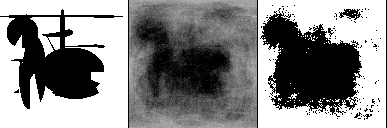

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.05442810058594


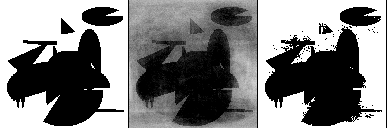

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.97637939453125


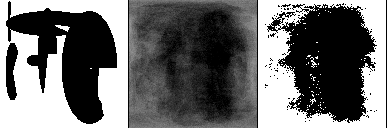

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean175.0088653564453


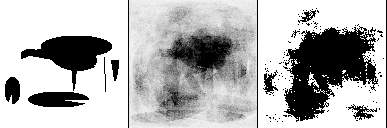

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean94.62889099121094


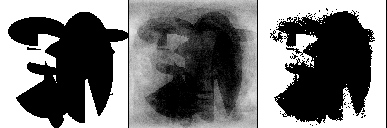

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean139.20880126953125


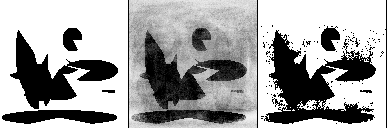

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.56340026855469


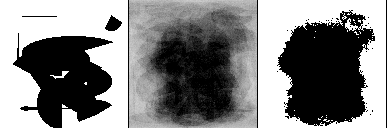

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.89889526367188


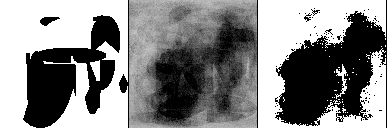

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.31243896484375


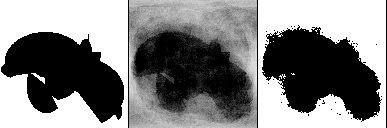

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.5062255859375


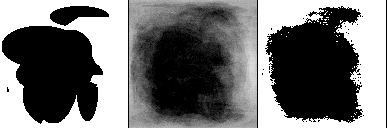

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean121.92627716064453


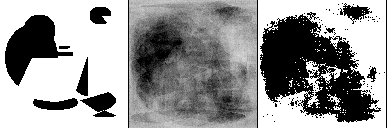

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.78575897216797


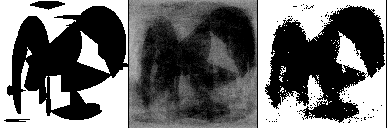

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean145.14996337890625


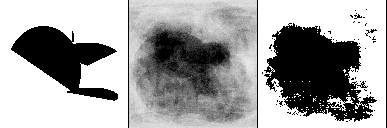

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.032073974609375


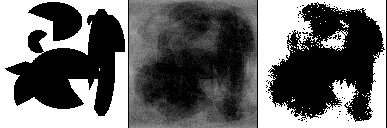

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.11424255371094


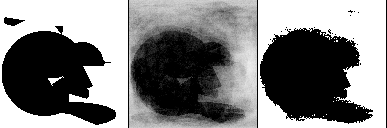

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean54.34984588623047


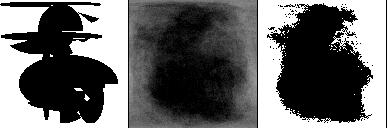

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.285099029541016


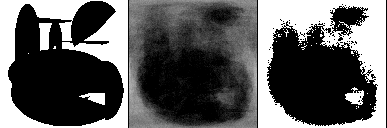

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.68196105957031


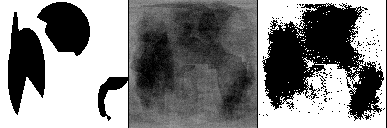

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.50664520263672


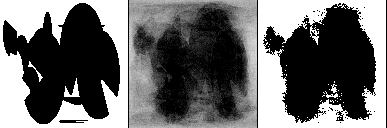

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.7564697265625


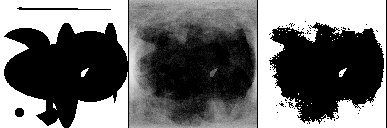

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.52497100830078


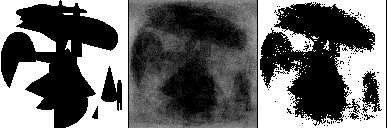

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.49325561523438


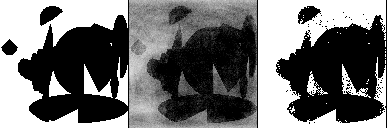

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.8055191040039


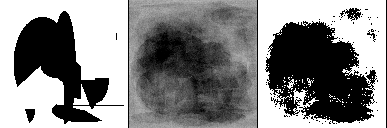

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.56399536132812


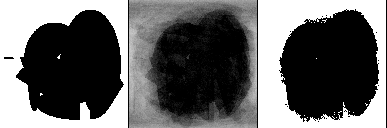

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.83528900146484


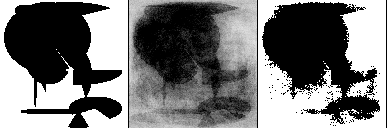

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean102.46923065185547


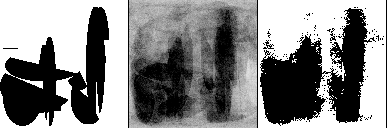

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.71745300292969


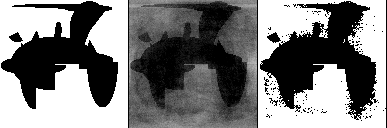

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.89262390136719


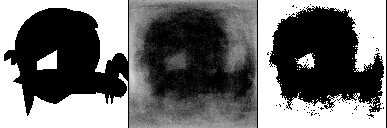

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean42.400856018066406


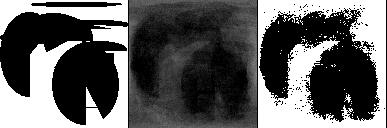

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.62767028808594


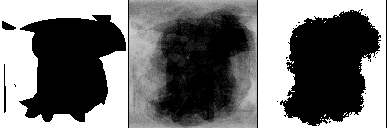

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.29422760009766


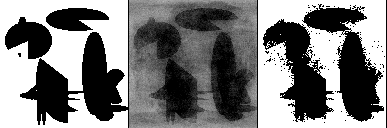

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean69.69573211669922


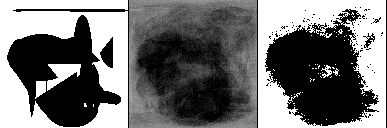

Step #13, will be saved as 'model-(013)-2src.*'


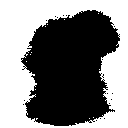

Epoch 1/6
2/2 [==============================] - 15s 7s/step - loss: -0.7957 - acc: 0.1460
Epoch 2/6
2/2 [==============================] - 14s 7s/step - loss: -0.8398 - acc: 0.1328
Epoch 3/6
2/2 [==============================] - 17s 9s/step - loss: -0.8607 - acc: 0.1080
Epoch 4/6
2/2 [==============================] - 14s 7s/step - loss: -0.8818 - acc: 0.1694
Epoch 5/6
2/2 [==============================] - 14s 7s/step - loss: -0.8978 - acc: 0.1667
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9112 - acc: 0.1417
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.69612121582031


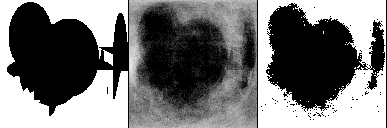

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.49864196777344


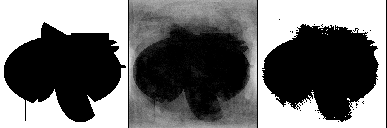

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.25982666015625


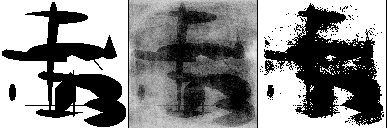

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.91860961914062


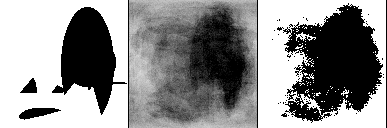

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.16886901855469


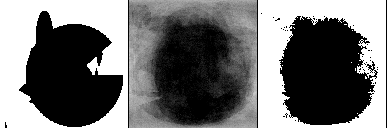

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean37.609458923339844


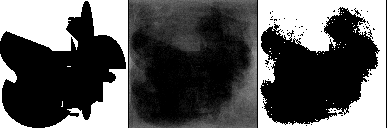

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.30278778076172


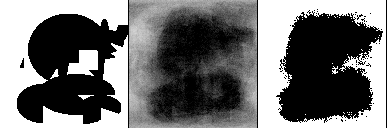

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean91.40555572509766


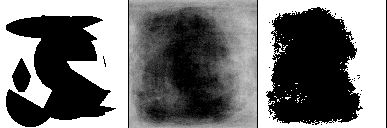

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.01480865478516


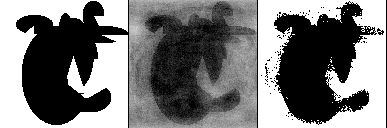

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.04365539550781


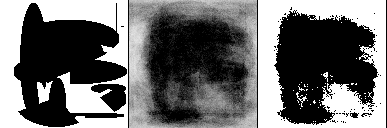

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.67218017578125


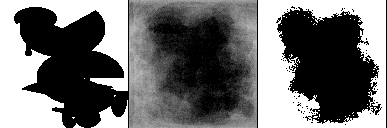

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.57530212402344


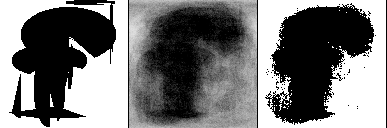

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean133.65432739257812


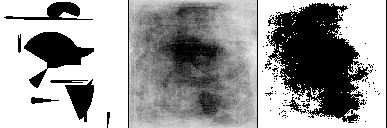

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean73.48167419433594


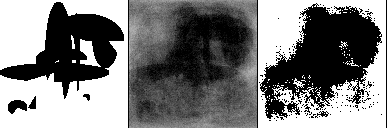

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.93375778198242


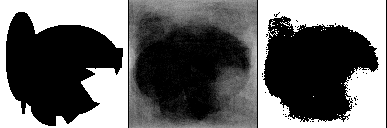

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.00357055664062


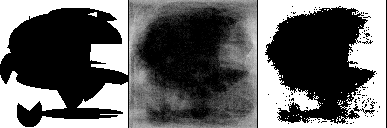

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.42337417602539


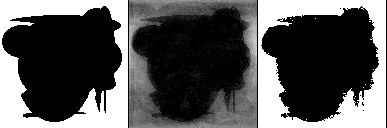

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.521995544433594


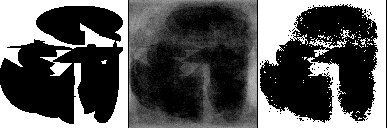

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.77181243896484


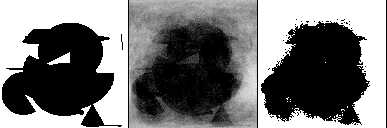

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean103.83795166015625


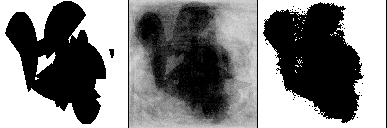

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.250370025634766


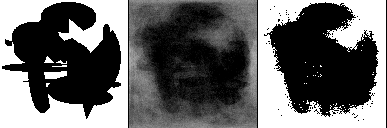

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean119.15938568115234


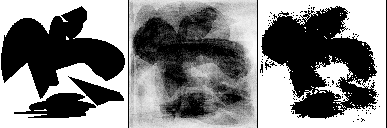

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean110.79156494140625


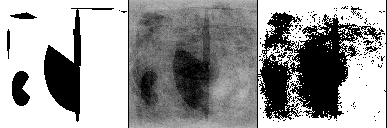

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean152.0348358154297


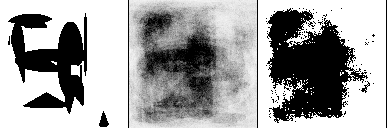

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean43.38416290283203


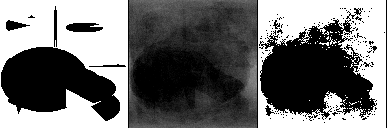

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean178.05819702148438


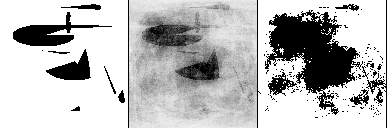

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.97783279418945


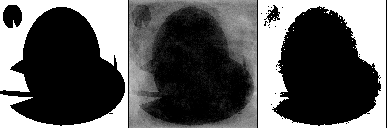

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean100.0612564086914


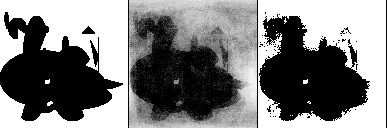

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean33.23697280883789


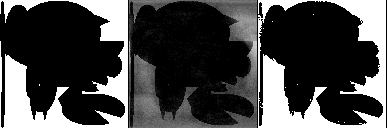

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.480934143066406


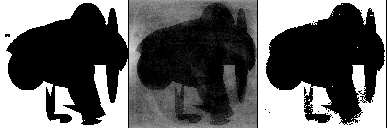

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.46839141845703


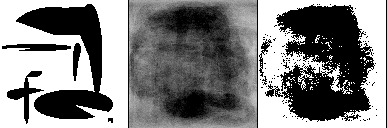

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean78.77355194091797


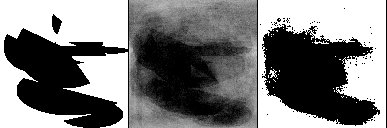

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean167.61676025390625


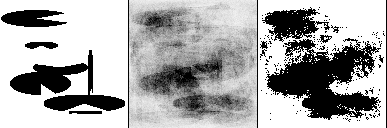

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.92593383789062


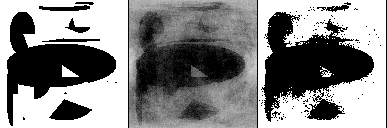

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.35293579101562


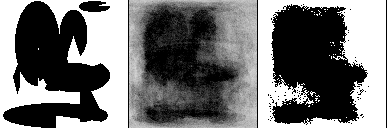

Step #14, will be saved as 'model-(014)-2src.*'


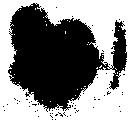

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.7891 - acc: 0.1029
Epoch 2/6
2/2 [==============================] - 11s 6s/step - loss: -0.8421 - acc: 0.1051
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8642 - acc: 0.1185
Epoch 4/6
2/2 [==============================] - 11s 5s/step - loss: -0.8843 - acc: 0.1246
Epoch 5/6
2/2 [==============================] - 11s 5s/step - loss: -0.8953 - acc: 0.1491
Epoch 6/6
2/2 [==============================] - 11s 5s/step - loss: -0.9166 - acc: 0.1815
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean116.24849700927734


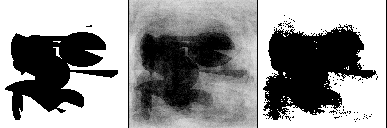

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean149.59620666503906


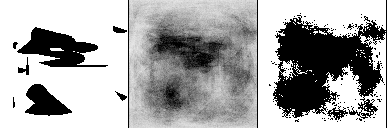

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean84.41806030273438


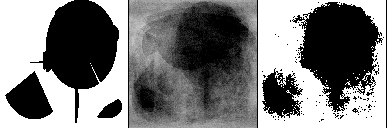

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.55767059326172


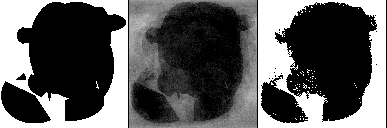

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.24990844726562


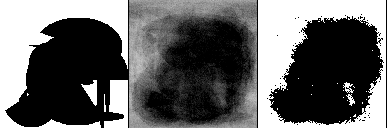

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean55.642059326171875


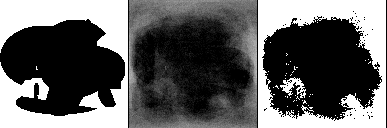

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean52.780765533447266


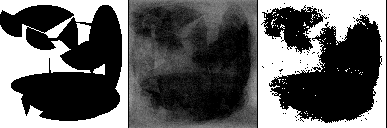

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean45.88580322265625


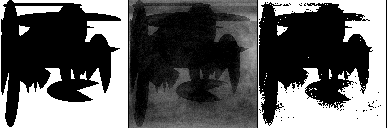

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.62449645996094


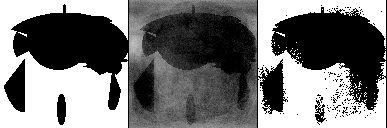

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.28546905517578


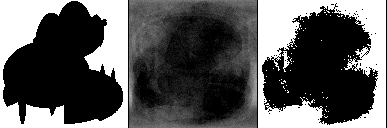

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.402000427246094


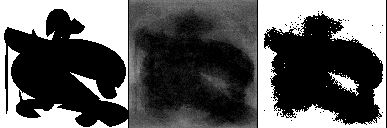

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean128.7394256591797


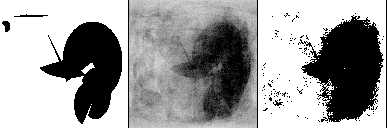

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.61846160888672


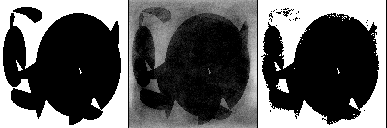

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean96.44491577148438


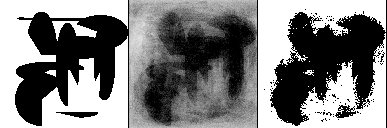

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean164.7209930419922


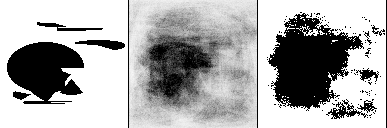

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean124.84452056884766


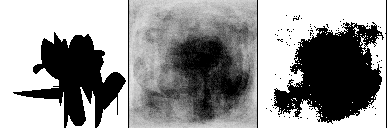

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.2510986328125


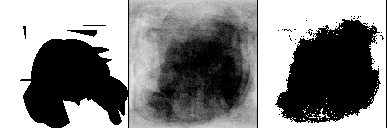

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.75834655761719


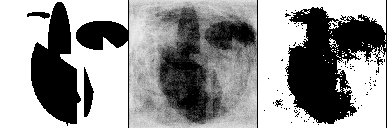

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.13682556152344


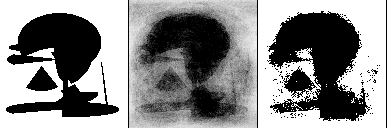

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.75115966796875


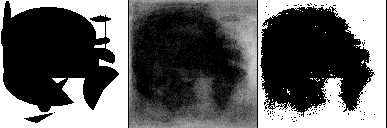

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.07402038574219


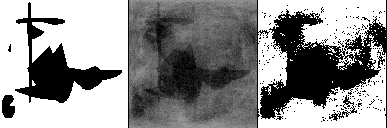

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean95.31891632080078


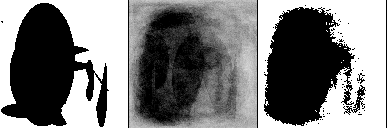

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.68872833251953


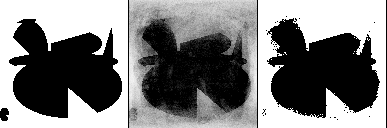

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.52816772460938


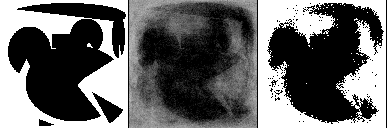

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean136.94097900390625


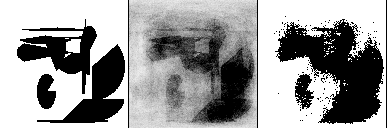

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.83010864257812


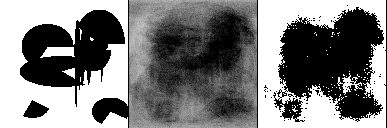

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.78837585449219


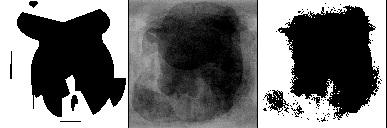

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean84.10090637207031


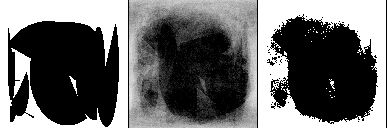

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.64083862304688


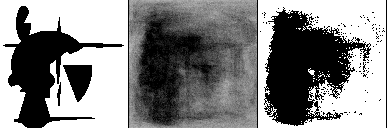

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean118.34708404541016


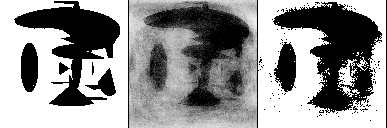

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.26362609863281


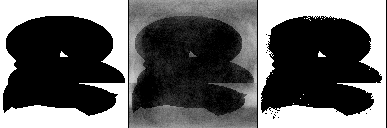

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean113.60520935058594


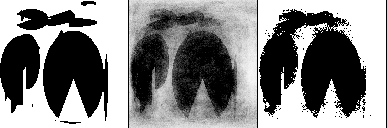

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean156.7730712890625


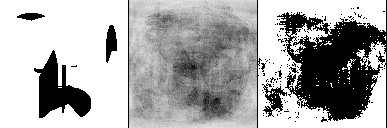

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean104.84278869628906


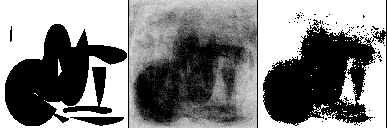

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean138.48419189453125


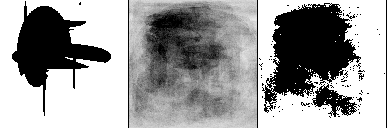

Step #15, will be saved as 'model-(015)-2src.*'


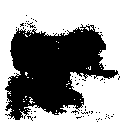

Epoch 1/6
2/2 [==============================] - 13s 7s/step - loss: -0.7950 - acc: 0.1232
Epoch 2/6
2/2 [==============================] - 12s 6s/step - loss: -0.8363 - acc: 0.0710
Epoch 3/6
2/2 [==============================] - 15s 8s/step - loss: -0.8711 - acc: 0.0871
Epoch 4/6
2/2 [==============================] - 11s 5s/step - loss: -0.8898 - acc: 0.1069
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.9036 - acc: 0.0951
Epoch 6/6
2/2 [==============================] - 11s 5s/step - loss: -0.9197 - acc: 0.1156
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.19281768798828


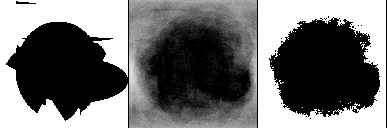

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.65604400634766


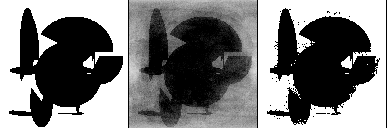

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean156.22035217285156


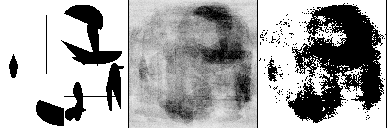

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.09660339355469


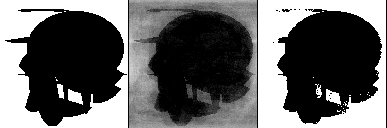

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean87.41565704345703


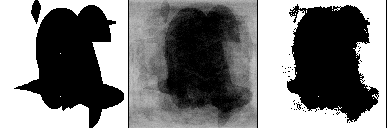

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.37553405761719


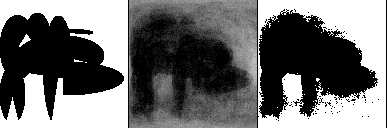

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.33797454833984


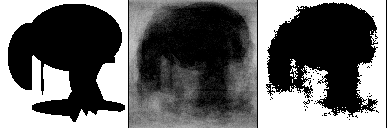

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean158.589111328125


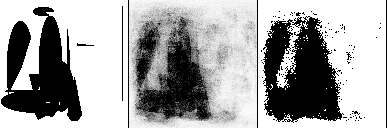

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean45.574546813964844


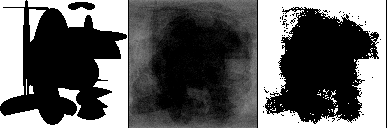

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.8492431640625


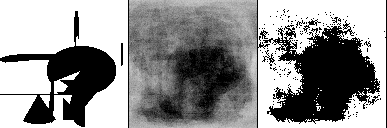

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean117.90167999267578


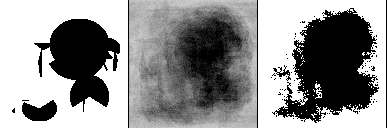

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean114.9844970703125


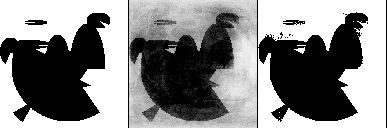

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean57.74138259887695


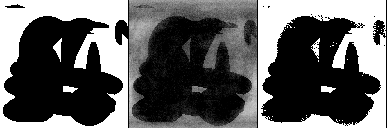

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean96.32937622070312


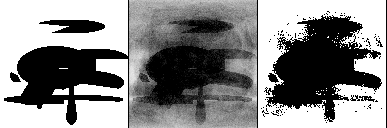

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.75167846679688


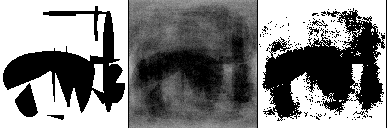

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean107.84237670898438


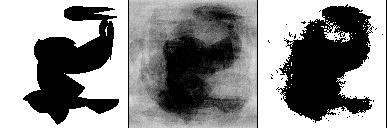

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean115.17413330078125


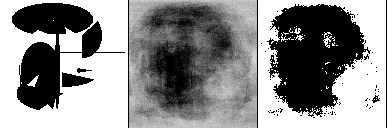

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.94601440429688


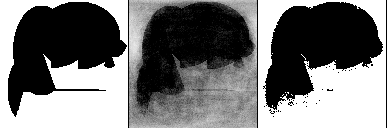

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean121.89204406738281


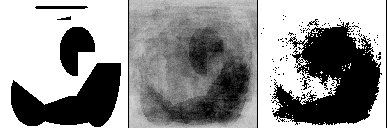

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean102.27162170410156


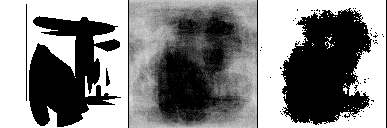

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean90.2843017578125


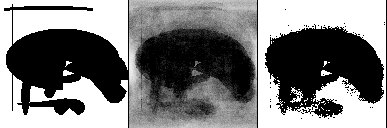

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.12333679199219


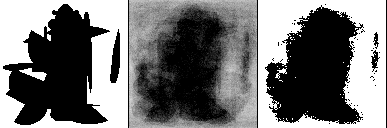

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.36447143554688


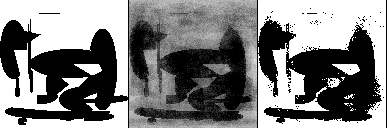

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.10653686523438


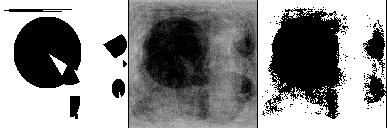

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean67.9635009765625


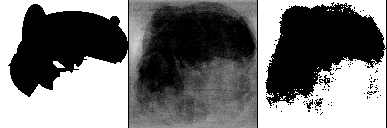

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.25902557373047


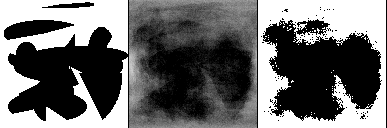

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean96.06581115722656


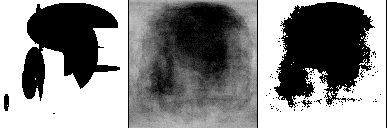

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.69286346435547


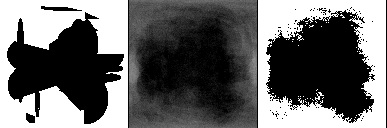

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean150.9256591796875


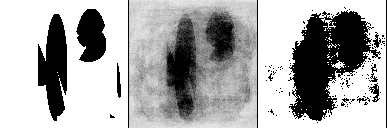

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.65098571777344


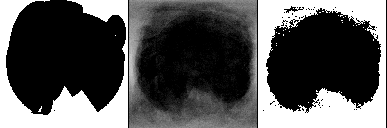

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.97065734863281


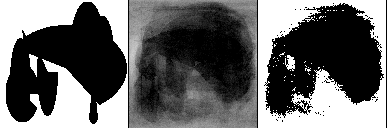

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean153.69140625


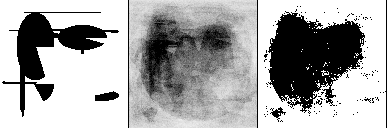

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.26469421386719


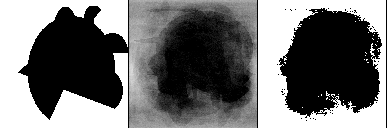

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.95941925048828


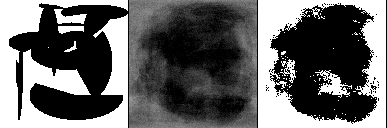

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean81.90611267089844


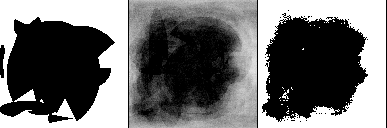

Step #16, will be saved as 'model-(016)-2src.*'


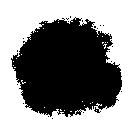

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.8107 - acc: 0.0710
Epoch 2/6
2/2 [==============================] - 11s 5s/step - loss: -0.8544 - acc: 0.0420
Epoch 3/6
2/2 [==============================] - 11s 6s/step - loss: -0.8701 - acc: 0.0645
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8886 - acc: 0.0730
Epoch 5/6
2/2 [==============================] - 11s 5s/step - loss: -0.9059 - acc: 0.0828
Epoch 6/6
2/2 [==============================] - 11s 6s/step - loss: -0.9148 - acc: 0.0826
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.75145721435547


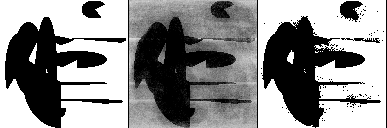

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.77046203613281


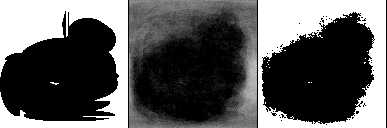

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.62039184570312


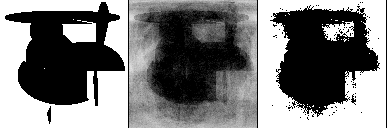

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean65.23194885253906


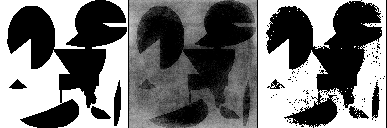

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.52784729003906


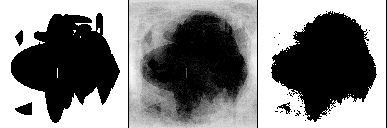

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.18614196777344


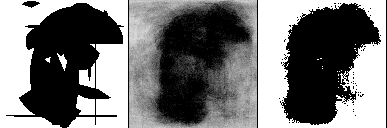

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.78556823730469


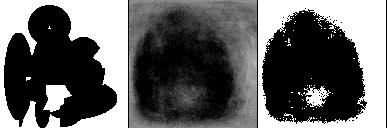

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean47.83112716674805


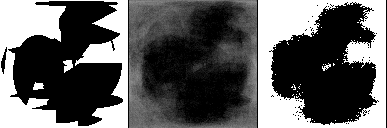

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean101.49052429199219


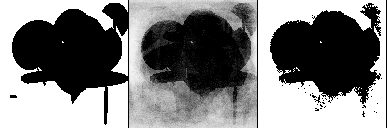

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean108.27655029296875


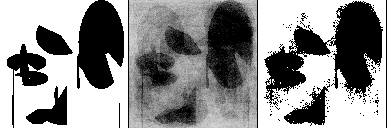

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.183349609375


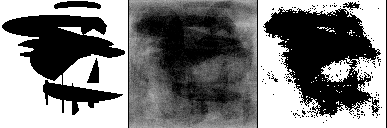

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean40.40757751464844


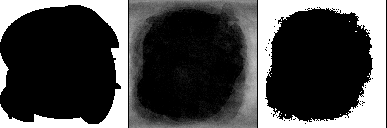

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.14464569091797


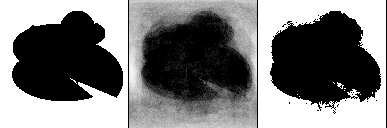

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.18408203125


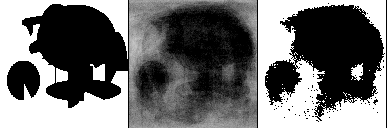

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.255531311035156


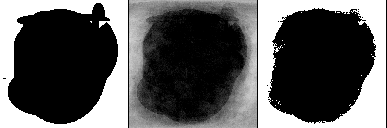

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean124.8385238647461


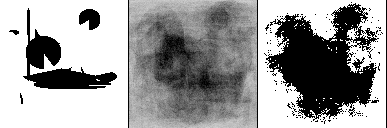

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.36067199707031


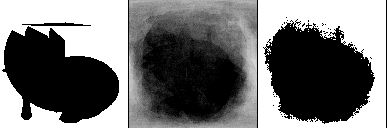

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean165.9141082763672


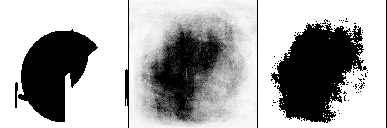

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean62.14757537841797


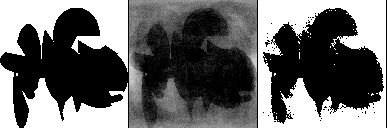

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean181.51446533203125


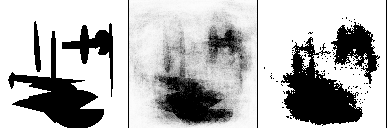

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.50753784179688


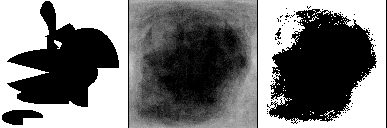

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean150.6773681640625


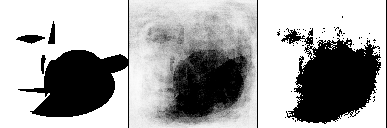

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.93544006347656


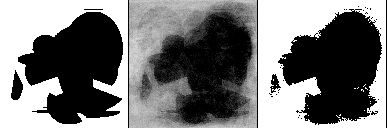

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean123.11831665039062


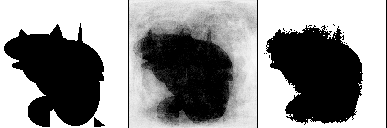

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.811004638671875


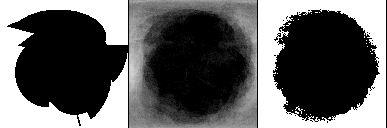

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean91.78004455566406


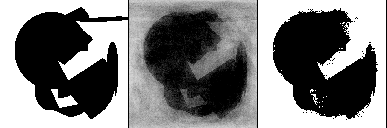

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean101.63714599609375


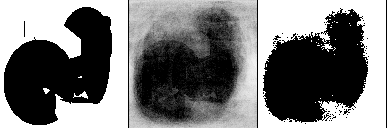

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.55276489257812


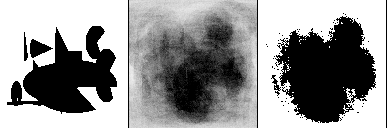

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean44.117210388183594


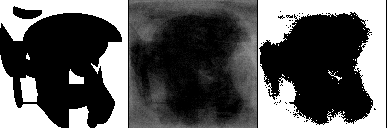

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.3138427734375


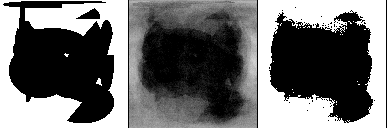

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.04730224609375


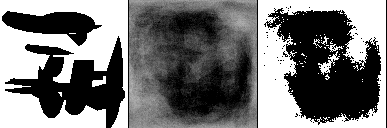

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.3399658203125


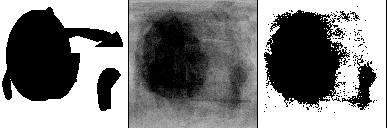

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.66273498535156


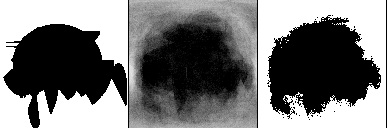

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.7176284790039


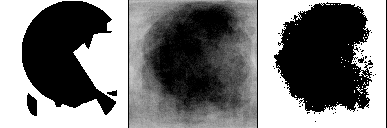

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean138.2248992919922


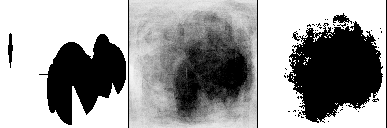

Step #17, will be saved as 'model-(017)-2src.*'


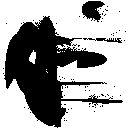

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.8104 - acc: 0.0654
Epoch 2/6
2/2 [==============================] - 15s 7s/step - loss: -0.8509 - acc: 0.0647
Epoch 3/6
2/2 [==============================] - 12s 6s/step - loss: -0.8749 - acc: 0.0797
Epoch 4/6
2/2 [==============================] - 12s 6s/step - loss: -0.8876 - acc: 0.1230
Epoch 5/6
2/2 [==============================] - 12s 6s/step - loss: -0.9070 - acc: 0.0991
Epoch 6/6
2/2 [==============================] - 12s 6s/step - loss: -0.9183 - acc: 0.0938
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.64393615722656


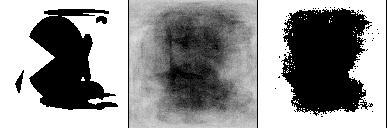

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean144.1560516357422


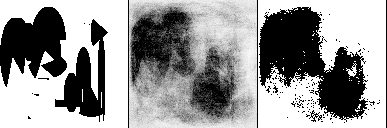

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.93348693847656


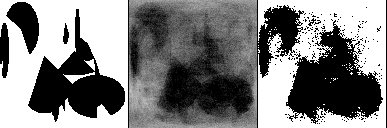

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean70.51728820800781


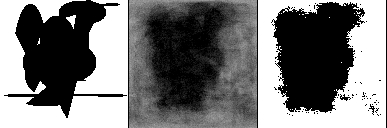

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.6463623046875


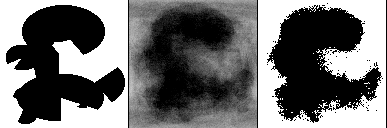

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean122.93374633789062


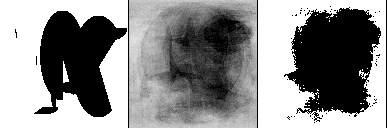

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.27837371826172


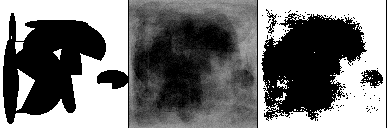

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.29122924804688


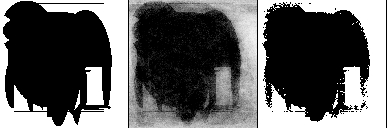

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean121.33428192138672


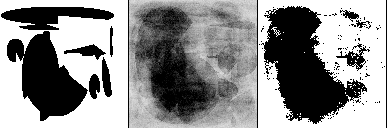

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean202.26548767089844


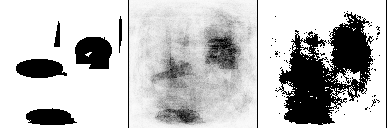

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean136.5703582763672


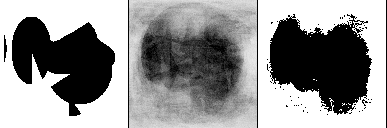

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.570068359375


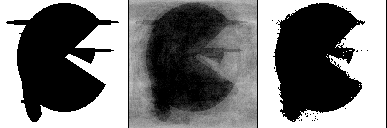

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean149.8982391357422


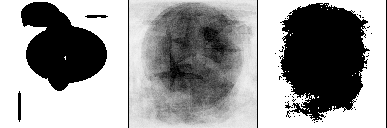

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.86093139648438


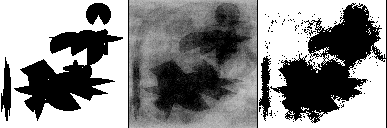

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.98680114746094


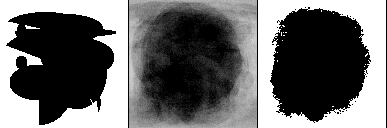

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean115.59539794921875


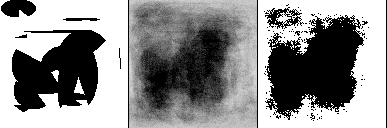

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.88981628417969


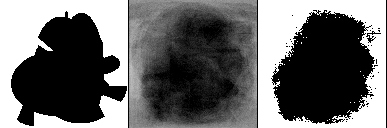

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean37.684600830078125


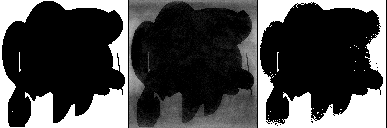

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.60974884033203


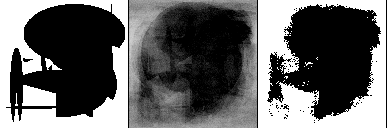

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.70683288574219


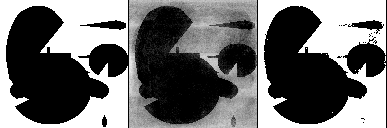

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean170.7420654296875


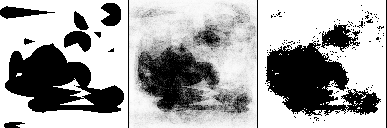

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean92.27855682373047


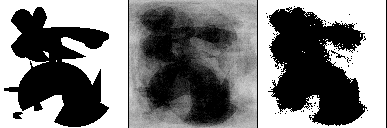

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean111.13187408447266


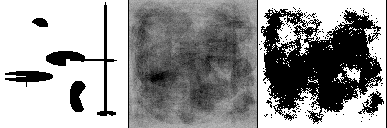

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean202.07778930664062


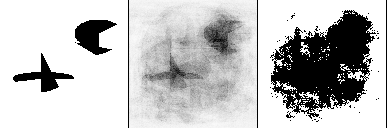

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean163.68719482421875


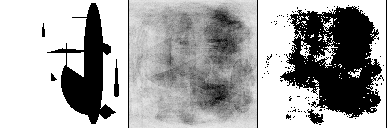

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean112.80467224121094


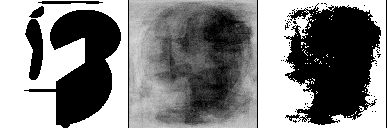

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean178.328369140625


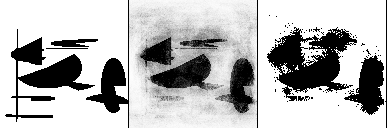

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.92377471923828


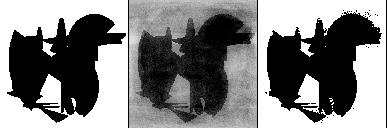

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean106.97860717773438


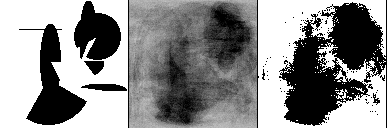

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean124.8719482421875


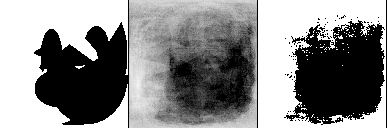

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean54.22486877441406


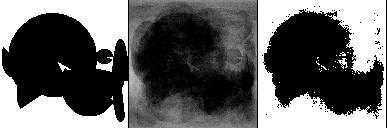

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean83.31648254394531


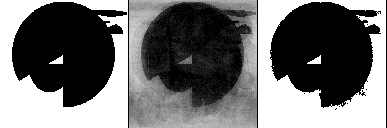

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean88.1762466430664


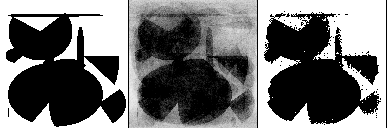

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.59982299804688


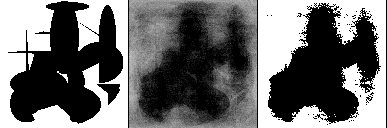

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean27.014909744262695


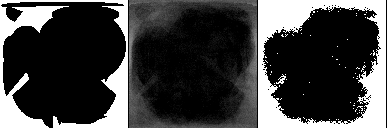

Step #18, will be saved as 'model-(018)-2src.*'


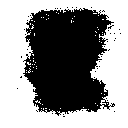

Epoch 1/6
2/2 [==============================] - 13s 6s/step - loss: -0.8009 - acc: 0.1205
Epoch 2/6
2/2 [==============================] - 10s 5s/step - loss: -0.8394 - acc: 0.0737
Epoch 3/6
2/2 [==============================] - 11s 5s/step - loss: -0.8659 - acc: 0.0938
Epoch 4/6
2/2 [==============================] - 11s 6s/step - loss: -0.8867 - acc: 0.1310
Epoch 5/6
2/2 [==============================] - 11s 5s/step - loss: -0.9052 - acc: 0.1382
Epoch 6/6
2/2 [==============================] - 11s 5s/step - loss: -0.9179 - acc: 0.1388
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.22173309326172


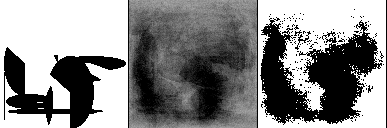

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean79.5422134399414


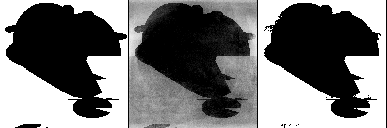

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean153.82135009765625


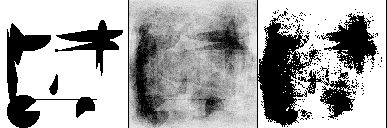

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean127.08126068115234


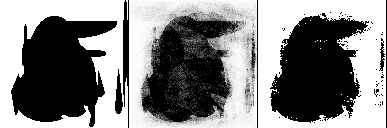

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean59.648529052734375


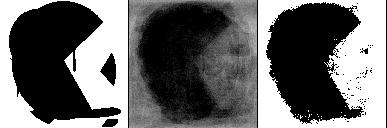

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean86.30340576171875


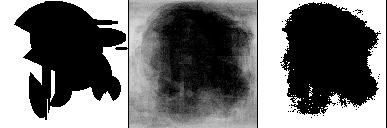

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.23723602294922


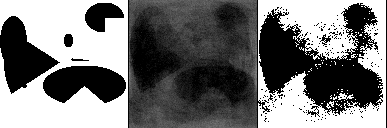

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean119.2812728881836


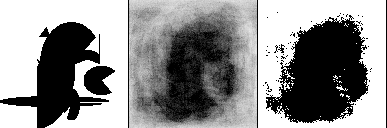

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.57440948486328


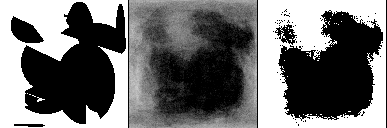

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean85.35274505615234


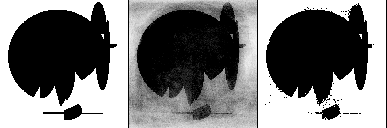

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.37850952148438


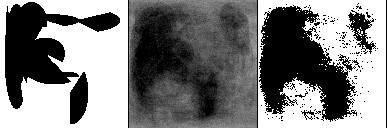

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.14543151855469


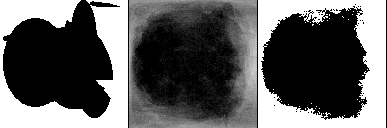

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean74.20536804199219


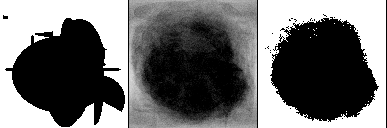

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.97938537597656


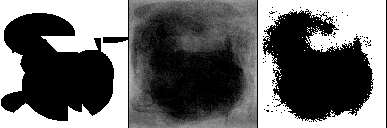

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean80.56056213378906


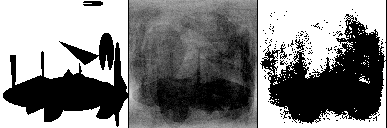

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean46.08144760131836


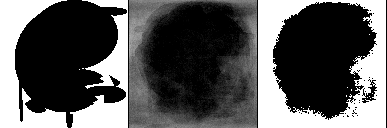

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean49.996604919433594


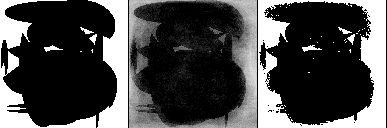

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean140.90997314453125


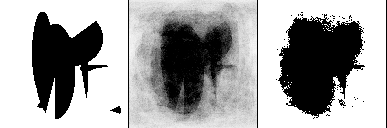

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.71981048583984


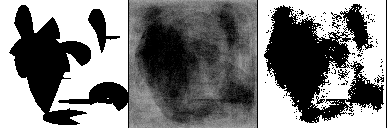

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean151.8559112548828


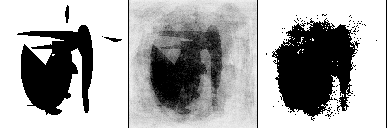

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean75.49545288085938


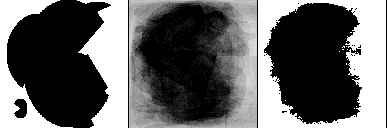

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean66.54855346679688


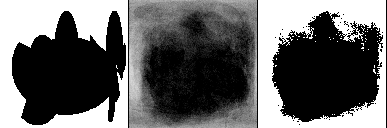

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean110.89380645751953


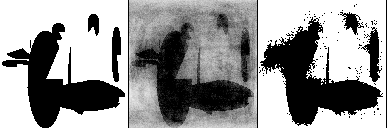

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean99.08700561523438


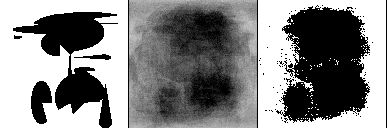

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.76359558105469


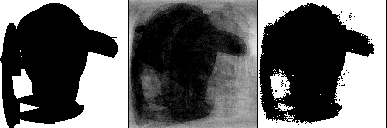

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean61.707340240478516


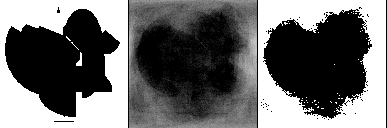

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean97.41924285888672


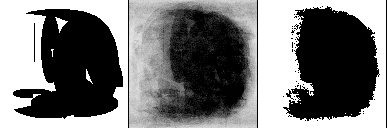

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.4007339477539


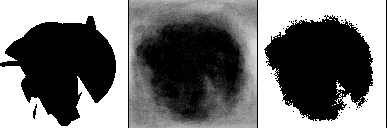

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean41.94446563720703


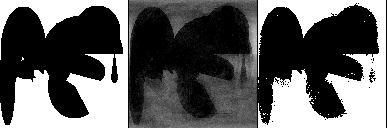

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean105.7176513671875


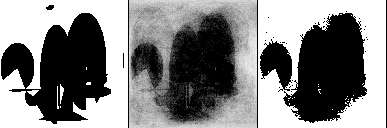

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.76519012451172


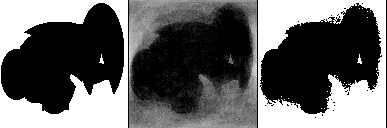

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.69679260253906


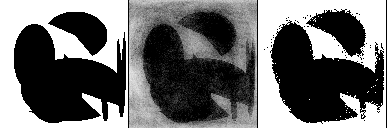

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean82.95140075683594


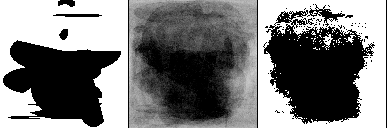

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean56.03002166748047


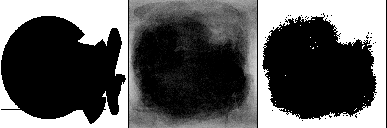

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean93.56330871582031


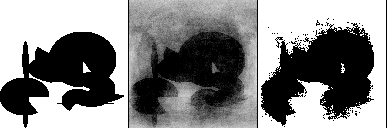

Step #19, will be saved as 'model-(019)-2src.*'


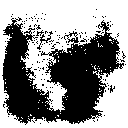

Epoch 1/6
2/2 [==============================] - 12s 6s/step - loss: -0.7872 - acc: 0.1562
Epoch 2/6
2/2 [==============================] - 11s 6s/step - loss: -0.8398 - acc: 0.1094
Epoch 3/6


In [ ]:

"""
train_x =np.random.randint(0, high=10, size=(32, 128, 128))
         
train_y = np.random.randint(0, high=1, size=(32, 128, 128))
"""
for i in range(0, N):
    train_x, train_y = generate_set(N+5)
    history = model.fit(train_x, train_y, epochs=N//5)
    prediction = model.predict(train_x)
    
    display_predict(prediction, train_y)
    v=prediction[0]
    v_mean = np.mean(v)
    iv = Image.fromarray( ((v > v_mean).astype(np.int)*Ynor).astype(np.uint8), 'L')
    fname = f"model-({i:03})-2src"
    print(f"Step #{i}, will be saved as '{fname}.*'")
    display(iv)
    # serialize model to JSON
    model_json = model.to_json()
    with open(f"{fname}.json", "w") as json_file:
        json_file.write(model_json)
    # serialize weights to HDF5
    model.save_weights(f"{fname}.h5")
    
 

In [12]:
print(history.history)
#
# model evaluation
T = 20
# make test set
test_x, test_y = generate_set(T)

test_scores = model.evaluate(test_x, test_y, verbose=2)
print(f'Test loss:{test_scores[0]}')
print(f'Test accuracy:{test_scores[1]}')


{'loss': [-0.7694674134254456, -0.8460808396339417, -0.8810033202171326, -0.9040765762329102, -0.9236754179000854, -0.940707802772522, -0.9534716606140137, -0.9634751677513123, -0.9715476036071777, -0.9778696298599243], 'acc': [0.04588068276643753, 0.05724431946873665, 0.12329545617103577, 0.14261363446712494, 0.12301136553287506, 0.09531249850988388, 0.06931818276643753, 0.04772727191448212, 0.03678977116942406, 0.036221589893102646]}
1/1 - 0s - loss: -7.9591e-01 - acc: 0.1406
Test loss:-0.7959145307540894
Test accuracy:0.140625


In [13]:
predict_in = test_x
prediction = model.predict(predict_in)
amax = np.amax(prediction)
p_mean = np.mean(prediction)
print(f"Shape={prediction.shape}, Max item = {amax}, mean={p_mean}")
#prediction= (prediction/amax)
#prediction[prediction > 1.]= 1.
#prediction[prediction < 0]= 0
for v in prediction:
    print(f"Sample:{v[43,17]}, max:{np.amax(v)}, min:{np.amin(v)}")

Shape=(20, 128, 128), Max item = 0.8293959498405457, mean=0.2152417153120041
Sample:0.2839685082435608, max:0.678070068359375, min:-0.18186405301094055
Sample:0.2724490463733673, max:0.5130172967910767, min:-0.08298162370920181
Sample:0.1882985681295395, max:0.5523083806037903, min:-0.09842251986265182
Sample:0.07005567103624344, max:0.4216814935207367, min:-0.0994943156838417
Sample:0.1933419108390808, max:0.5438013672828674, min:-0.09864231199026108
Sample:0.3797163665294647, max:0.8283556699752808, min:-0.19129744172096252
Sample:0.13922959566116333, max:0.502421498298645, min:-0.15323659777641296
Sample:0.28498807549476624, max:0.6843668222427368, min:-0.1581922471523285
Sample:0.15179921686649323, max:0.5517576336860657, min:-0.11069878935813904
Sample:0.14578978717327118, max:0.7326148748397827, min:-0.18606214225292206
Sample:0.1468915045261383, max:0.42263272404670715, min:-0.1073487401008606
Sample:0.15709903836250305, max:0.4134197235107422, min:-0.10830186307430267
Sample:0.

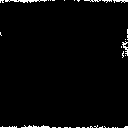

In [14]:
v=prediction[0]
iv = Image.fromarray( ((v > 0.6).astype(np.int)*Ynor).astype(np.uint8), 'L')
display(iv)


Source Max item=1.0, source-shape:(20, 128, 128), predictions-shape:(20, 128, 128)
Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean60.99176788330078


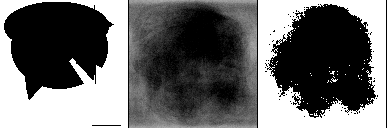

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean48.47798156738281


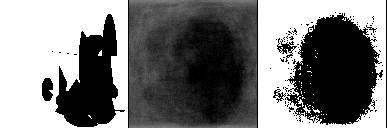

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean51.468101501464844


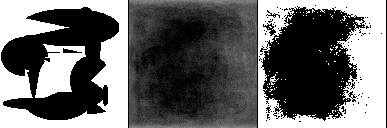

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean32.494163513183594


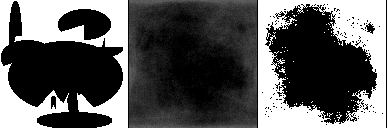

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean50.10978317260742


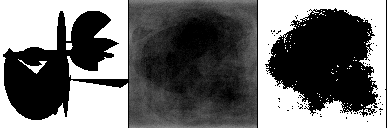

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean91.08464050292969


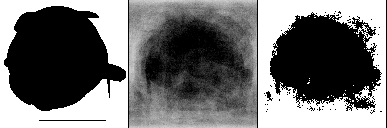

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean39.59306335449219


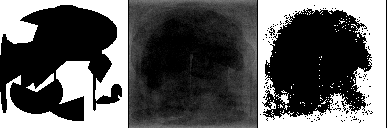

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean61.04334259033203


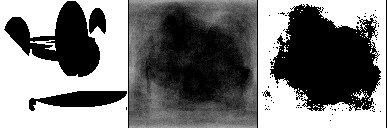

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean38.933406829833984


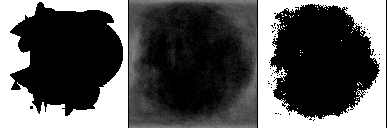

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.07202911376953


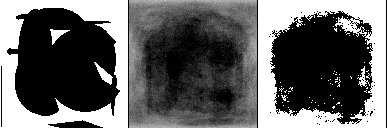

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean36.69730758666992


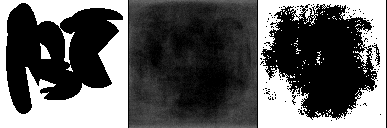

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean29.055727005004883


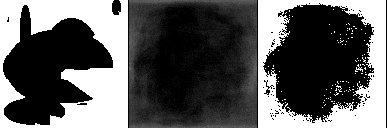

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean58.60258102416992


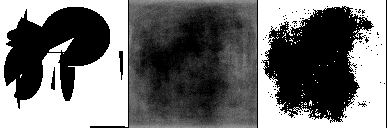

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean77.1943588256836


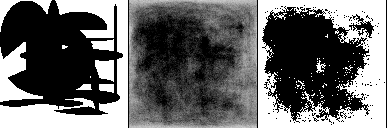

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean34.5203857421875


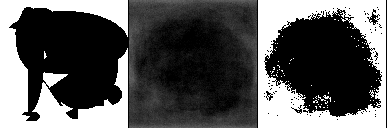

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean64.02774810791016


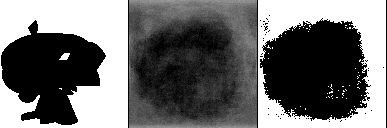

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean72.62320709228516


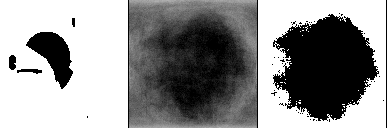

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean21.588397979736328


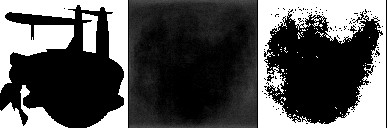

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean89.57565307617188


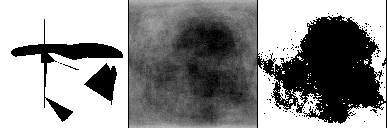

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean68.57923126220703


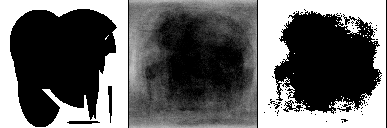

In [15]:
print(f"Source Max item={np.amax(test_y)}, source-shape:{test_y.shape}, predictions-shape:{prediction.shape}")
# ix = Image.fromarray((target_y[0]*255).astype(np.int8), 'L') 
 
display_predict(prediction, test_y)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
inp-top (InputLayer)            [(None, 128, 64)]    0                                            
__________________________________________________________________________________________________
inp-left (InputLayer)           [(None, 128, 64)]    0                                            
__________________________________________________________________________________________________
inp-interlaced (InputLayer)     [(None, 128, 128)]   0                                            
__________________________________________________________________________________________________
dense-inp_top (Dense)           (None, 128, 32)      2080        inp-top[0][0]                    
______________________________________________________________________________________________

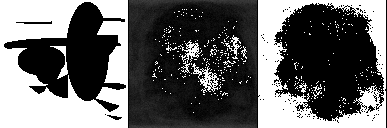

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean76.64105224609375


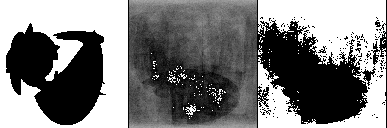

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean11.788684844970703


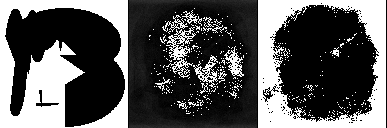

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean38.56842803955078


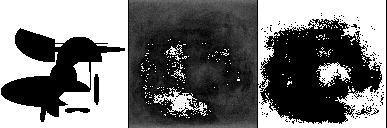

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean23.766292572021484


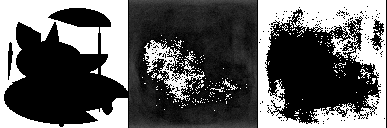

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean129.35494995117188


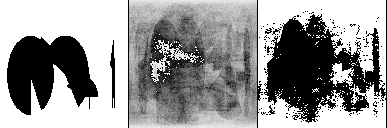

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean40.4783821105957


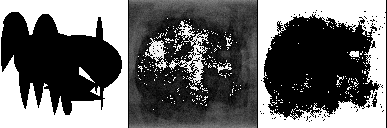

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean71.19798278808594


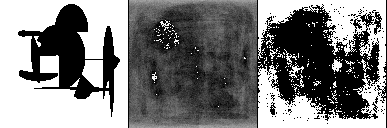

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean53.03567123413086


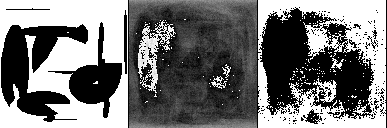

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean39.023258209228516


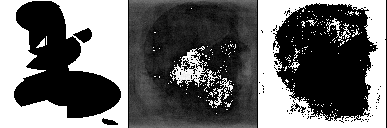

Source item-max=255, source-shape:(128, 128), predictions: shape:(128, 128) :mean31.616226196289062


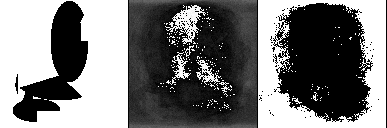

In [5]:
# load json and create model
predict_in, test_y = generate_set(11)
fname = 'model-(014)-2src'#best-2-lstm(004).json "relu-model-(054)-2src"
json_file = open(f'{fname}.json', 'r')
loaded_model_json = json_file.read()
json_file.close()

loaded_model = keras.models. model_from_json(loaded_model_json)
loaded_model.summary()
# load weights into new model
loaded_model.load_weights(f"{fname}.h5")
print("Loaded model from disk")
prediction = loaded_model.predict(predict_in) 
display_predict(prediction, test_y)
##########################


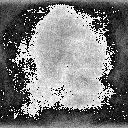

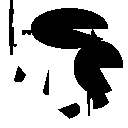

In [9]:
train_x, train_y = generate_set(N+5)
prediction = loaded_model.predict(train_x)
v=prediction[0]
#print(f"max={np.amax(v)}, min={np.amin(v)}")
v = (v + np.amin(v)) * Ynor /np.amax(v)
iv = Image.fromarray( v.astype(np.uint8), 'L')
display(iv)

y = train_y[0]
y = (y + np.amin(y)) * Ynor /np.amax(y)
iy = Image.fromarray( y.astype(np.uint8), 'L')
display(iy)

